In [1]:
import numpy as np
import tensorflow as tf

import os
# np.random.seed(1337)  # for reproducibility
# tf.random.set_seed(1337)
# os.environ['TF_DETERMINISTIC_OPS'] = '1'
# os.environ['TF_CUDNN_DETERMINISTIC '] = '1'


# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [1]:
from data.utils import load_data
from data.scaling import normalize

filtro_tipos_eventos_permitidos = ['listing', 'launch']
query_str = 'title.isna()'
for filtro in filtro_tipos_eventos_permitidos:
    query_str += f' or title.str.lower().str.contains("{filtro}")'
    # df = df.query(f'event_title.isna() or event_title.str.lower().str.contains("{filtro}")')
print(query_str)

coin = 'TRX'
df = load_data(coin, 'tron', event_days_left_lookback=7, storage_folder='../data', events_query=query_str)
df.head()

title.isna() or title.str.lower().str.contains("listing") or title.str.lower().str.contains("launch")


ValueError: The truth value of a DataFrame is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

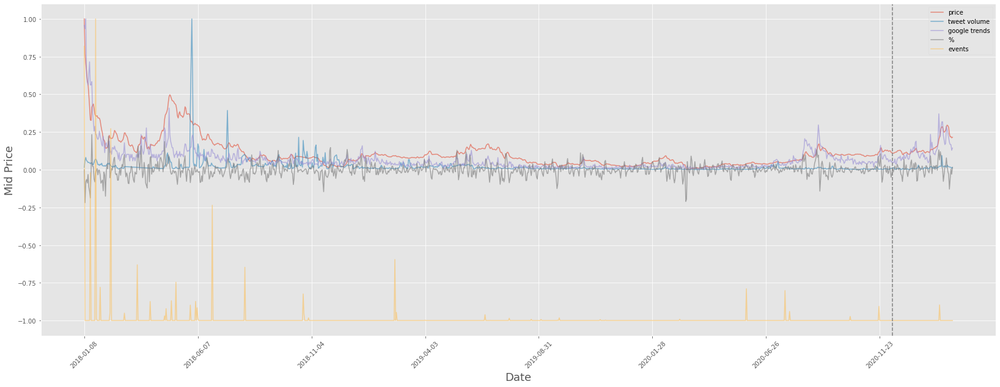

<module 'matplotlib.pyplot' from 'C:\\Users\\jgmu6\\AppData\\Local\\Programs\\Python\\Python38\\lib\\site-packages\\matplotlib\\pyplot.py'>

In [3]:
from data.visualization import plot_data
import pandas as pd
prices, _ = normalize(df.loc[:, 'price'].to_numpy(), range=(0,1))
variation = df.loc[:, 'price'].pct_change().fillna(0).to_numpy()
tweet, _ = normalize(df.loc[:, 'tweet_volume'].to_numpy(), range=(0,1))
google_trends, _ = normalize(df.loc[:, 'trend'].to_numpy(), range=(0,1))
events, _ = normalize((df.loc[:, 'event_votes'].fillna(0)).to_numpy(), range=(-1,1))
plot_data([prices, tweet, google_trends, variation, events], 
          legends=['price', 'tweet volume', 'google trends', '%', 'event announcement (votes)'], tick=150,
          verticalLineAt=len(prices)*0.93, labels=df.index.date[::150], blocking=False)

In [4]:
prices, _ = normalize(df.loc[:, 'price'].to_numpy())
variation = df.loc[:, 'price (%)'].to_numpy()
# variation = df.loc[:, 'price'].pct_change().fillna(0).to_numpy()
volume, _ = normalize(df['Volume'].to_numpy())
volume_variation = df['Volume'].pct_change().fillna(0).to_numpy()
tweet, _ = normalize(df.loc[:, 'tweet_volume'].to_numpy())
tweet_variation = df.loc[:, 'tweet_volume'].pct_change().fillna(0).to_numpy()
google_trends, _ = normalize(df.loc[:, 'trend'].to_numpy())
google_trends_variation = df.loc[:, 'trend'].pct_change().fillna(0).to_numpy()

prices[:3], variation[:3], google_trends[:3]

(array([1.        , 0.53728247, 0.40496258]),
 array([-0.04324555, -0.21904711, -0.08020877]),
 array([0.91238975, 0.86858462, 1.        ]))

In [5]:
# event_day_count, _ = normalize(df.loc[:, 'days_to_event_happen'].fillna(0).to_numpy())
event_votes, votes_scaler = normalize(df.loc[:, 'event_votes'].fillna(0).to_numpy(), range=(0,1))
event_confidence, conf_scaler = normalize(df.loc[:, 'event_confidence'].to_numpy(), range=(-1,1))   # mantém os nan fora da normalização, e então converte para 0.0
event_confidence = np.nan_to_num(event_confidence)
event_votes_features = [event_votes]
event_confidence_features = [event_confidence]
for i in range(5):
    votes, confidence = df[f'event_in_{i+1}_days_votes'].to_numpy(), df[f'event_in_{i+1}_days_confidence'].to_numpy()
    votes =  votes_scaler.transform(votes.reshape(-1,1)).reshape(-1)
    confidence =  conf_scaler.transform(confidence.reshape(-1,1)).reshape(-1)
    confidence = np.nan_to_num(confidence)

    event_votes_features.append(votes)
    event_confidence_features.append(confidence)

In [6]:
from typing import Tuple
# look_behind: passos (dias) anteriores usados para prever o proximo.
N = 30
foward_days = 1  # quantos dias prever
used_features_names = ['price', 'variation', 'volume']
features = [prices, variation, volume, volume_variation] #+ event_votes_features + event_confidence_features
target = prices

def to_keras_format(features: list, target) -> Tuple[np.array, np.array]:
    n_samples = len(target) - N - (foward_days-1)
    # matriz de dimensao: [n_samples, N, n_features];
    features_set = np.empty((n_samples, N, len(features)))  # type: np.ndarray
    labels = [None]*n_samples
    for i in range(n_samples):
        for j in range(N):
            for ft_idx in range(len(features)):
                feature = features[ft_idx]
                features_set[i, j, ft_idx] = feature[i+j]

        labels[i] = target[N+i-1: N+i+foward_days]
    labels = np.array(labels)

    return features_set, labels

features_set, labels = to_keras_format(features, target)


In [7]:
from data.utils import split_data
print('dividindo os dados em treino e teste')
# shuffle_mask = np.arange(len(features_set))
# np.random.shuffle(shuffle_mask)
# features_set_shuffled, labels_shuffled = features_set[shuffle_mask], labels[shuffle_mask]

train_X, test_X = split_data(features_set, ratio=0.90)
train_y, test_y = split_data(labels, ratio=0.90)

dividindo os dados em treino e teste


In [8]:
from keras.models import Model
from keras.layers import Input, LSTM, Dropout, Dense

def build_model(train_X, train_y) -> Model:
    inputs = Input(shape=train_X.shape[1:])
    # lstm = LSTM(units=250, return_sequences=True, input_shape=train_X.shape[1:])(inputs)
    # lstm = Dropout(0.15)(lstm)

    lstm = LSTM(units=750, return_sequences=False, input_shape=train_X.shape[1:])(inputs)
    lstm = Dropout(0.1)(lstm)
    x = lstm
    # time_embedding = TimeDistributed(Time2Vec(kernel_size=1))(lstm)
    # x = concatenate([lstm, time_embedding], -1)

    # x = tf_MultiHeadAttention(num_heads=4, head_size=96,output_size=250,  dropout=0.15)((x,x))
    # x = LayerNormalization(epsilon=1e-6)(Add()([lstm,x]))
    # x = Conv1D(filters=128, kernel_size=1, activation='relu')(x)
    # x = LayerNormalization(epsilon=1e-6)(Add()([lstm,x]))

    # avg_pool = GlobalAveragePooling1D()(x)
    # x = GlobalMaxPooling1D()(lstm)
    # x = concatenate([avg_pool, max_pool])

    x = Dense(units=175, activation='linear')(x)
    x = Dropout(0.1)(x)
    x = Dense(units=75, activation='linear')(x)
    x = Dropout(0.1)(x)
    x = Dense(units=foward_days)(x)
    return Model(inputs=inputs, outputs=x)

In [17]:
from matplotlib import pyplot as plt
# vizualizando estatisticas do modelo em si e seu treino
def plot_train_history(modelo: Model, plot_above_or_below_zero_accuracy: bool, figsize=(25,10)):
    plt.rcParams['figure.figsize'] = figsize
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)
    # plt.figure(figsize=(20, 8))
    ax1.plot(modelo.history.history['loss'])
    ax1.plot(modelo.history.history['val_loss'])
    ax1.title.set_text('model loss')
    ax1.set_ylabel('loss')
    ax1.set_xlabel('epoch')
    ax1.legend(['train', 'test'], loc='upper left')
    # ax1.show(block=True)

    ax2.plot(modelo.history.history['mean_squared_error'])
    ax2.plot(modelo.history.history['val_mean_squared_error'])
    ax2.title.set_text('model meanSquaredError')
    ax2.set_ylabel('mse')
    ax2.set_xlabel('epoch')
    ax2.legend(['train', 'test'], loc='upper left')
    # ax2.show(block=True)

    ax3.plot(modelo.history.history['movement_accuracy'])
    ax3.plot(modelo.history.history['val_movement_accuracy'])
    ax3.title.set_text('model movement direction accuracy')
    ax3.set_ylabel('accuracy')
    ax3.set_xlabel('epoch')
    ax3.legend(['train', 'test'], loc='upper left')
    # ax3.show(block=True)

    # plote esse apenas se seu dado target for de variação (não faz sentido para dado bruto)
    if plot_above_or_below_zero_accuracy:
        ax4.plot(modelo.history.history['above_or_below_zero_accuracy'])
        ax4.plot(modelo.history.history['val_above_or_below_zero_accuracy'])
        ax4.title.set_text('price up or down accuracy *')
        ax4.set_ylabel('accuracy')
        ax4.set_xlabel('epoch')
        ax4.legend(['train', 'test'], loc='upper left')
        # ax4.show(block=True)
    plt.tight_layout()
    plt.show()

In [19]:
from keras.losses import mean_squared_error as keras_mean_squared_error, cosine_similarity as keras_cosine_similarity
from metrics.custom import custom_loss2, custom_loss, custom_movement_accuracy, above_or_below_zero_accuracy, movement_accuracy
from metrics.custom import mean_squared_error, cosine_similarity as custom_cosine_similarity

tf.keras.backend.clear_session() #limpa modelos e dados anteriores, para evitar vazamento de memoria

features = [variation, volume_variation] #+ event_features
target = variation

features_set, labels = to_keras_format(features, target)
train_X, test_X = split_data(features_set, ratio=0.85)
train_y, test_y = split_data(labels, ratio=0.85)


modelo = build_model(train_X, train_y)

opt = tf.keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
modelo.compile(optimizer=opt, loss=mean_squared_error, metrics=[mean_squared_error, movement_accuracy, above_or_below_zero_accuracy])# 'cosine_similarity', 'mean_squared_error'
modelo.fit(train_X, train_y, validation_data=(test_X, test_y), epochs=400, batch_size=128)  # validation_data=(test_X, test_y)

al_movement_accuracy: 0.7219 - val_above_or_below_zero_accuracy: 0.7078
Epoch 338/400
8/8 [==============================] - 0s 37ms/step - loss: 7.7648e-04 - mean_squared_error: 7.8206e-04 - movement_accuracy: 0.7287 - above_or_below_zero_accuracy: 0.7501 - val_loss: 8.1178e-04 - val_mean_squared_error: 0.0010 - val_movement_accuracy: 0.7258 - val_above_or_below_zero_accuracy: 0.6867
Epoch 339/400
8/8 [==============================] - 0s 37ms/step - loss: 7.9264e-04 - mean_squared_error: 7.9774e-04 - movement_accuracy: 0.7297 - above_or_below_zero_accuracy: 0.7584 - val_loss: 7.8497e-04 - val_mean_squared_error: 0.0010 - val_movement_accuracy: 0.7375 - val_above_or_below_zero_accuracy: 0.7437
Epoch 340/400
8/8 [==============================] - 0s 38ms/step - loss: 8.0159e-04 - mean_squared_error: 8.0768e-04 - movement_accuracy: 0.7306 - above_or_below_zero_accuracy: 0.7637 - val_loss: 8.2342e-04 - val_mean_squared_error: 0.0011 - val_movement_accuracy: 0.7055 - val_above_or_below_ze

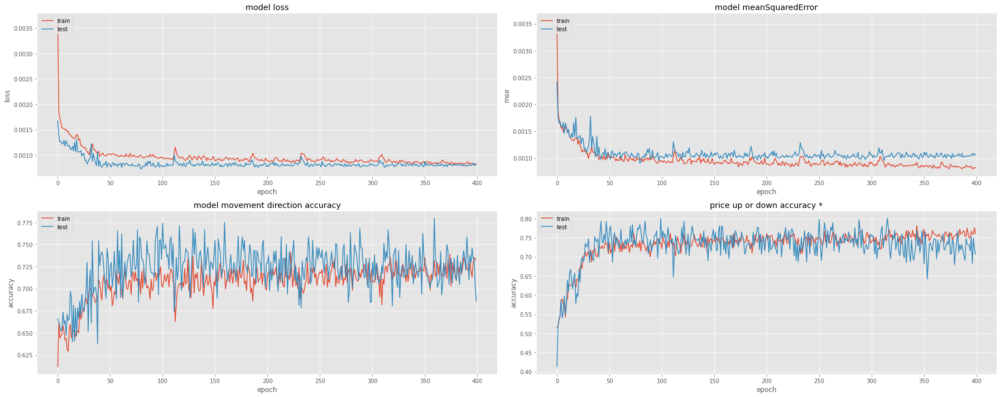

11/11 [==============================] - 0s 7ms/step - loss: 8.1650e-04 - mean_squared_error: 8.8723e-04 - movement_accuracy: 0.6818 - above_or_below_zero_accuracy: 0.6932
Train Score: [0.0007955802720971406, 0.0007958991336636245, 0.7339583039283752, 0.7695833444595337]
Test Score: [0.0008164981263689697, 0.0008872284088283777, 0.6818181872367859, 0.6931818127632141]
Cosine similarity -0.9700966
Mean Square Error 0.0008164981
Movement accuracy 0.6785714


In [20]:
plot_train_history(modelo, plot_above_or_below_zero_accuracy=True)

train_score = modelo.evaluate(x=train_X, y=train_y, batch_size=16)
test_score = modelo.evaluate(x=test_X, y=test_y, batch_size=16)
print('Train Score:', train_score)
print('Test Score:', test_score)
#predictions = scaler.inverse_transform(predictions)

#timestep_size = 1./len(features_set)
testPredict = modelo.predict(test_X)

timestep_size = 0.1
original_vectors = [[timestep_size, test_y[i, -1] - test_y[i-1, -1]] for i in range(1, len(test_y))]
prediction_vectors = [[timestep_size, testPredict[i, -1] - test_y[i-1, -1]] for i in range(1, len(test_y))]
cos_similarity = np.mean(keras_cosine_similarity(original_vectors, prediction_vectors))
print('Cosine similarity %s' % cos_similarity)
mse = mean_squared_error(test_y, testPredict).numpy()
print('Mean Square Error %s' % mse)
upDownScore = movement_accuracy(test_y, testPredict).numpy()
print('Movement accuracy %s' % upDownScore)

In [21]:
tf.keras.backend.clear_session() #limpa modelos e dados anteriores, para evitar vazamento de memoria

features = [variation] #+ event_features
target = variation

features_set, labels = to_keras_format(features, target)
train_X, test_X = split_data(features_set, ratio=0.85)
train_y, test_y = split_data(labels, ratio=0.85)


modelo = build_model(train_X, train_y)

opt = tf.keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
modelo.compile(optimizer=opt, loss=mean_squared_error, metrics=[mean_squared_error, movement_accuracy, above_or_below_zero_accuracy])# 'cosine_similarity', 'mean_squared_error'
modelo.fit(train_X, train_y, validation_data=(test_X, test_y), epochs=400, batch_size=128)  # validation_data=(test_X, test_y)

e_or_below_zero_accuracy: 0.7601 - val_loss: 8.0439e-04 - val_mean_squared_error: 0.0010 - val_movement_accuracy: 0.7711 - val_above_or_below_zero_accuracy: 0.7773
Epoch 338/400
8/8 [==============================] - 0s 34ms/step - loss: 9.3726e-04 - mean_squared_error: 9.4757e-04 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7421 - val_loss: 7.8565e-04 - val_mean_squared_error: 0.0010 - val_movement_accuracy: 0.7469 - val_above_or_below_zero_accuracy: 0.7844
Epoch 339/400
8/8 [==============================] - 0s 35ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7164 - above_or_below_zero_accuracy: 0.7437 - val_loss: 7.9653e-04 - val_mean_squared_error: 0.0011 - val_movement_accuracy: 0.7477 - val_above_or_below_zero_accuracy: 0.7648
Epoch 340/400
8/8 [==============================] - 0s 35ms/step - loss: 9.7293e-04 - mean_squared_error: 9.7346e-04 - movement_accuracy: 0.7323 - above_or_below_zero_accuracy: 0.7428 - val_loss: 7.7753e-04 - va

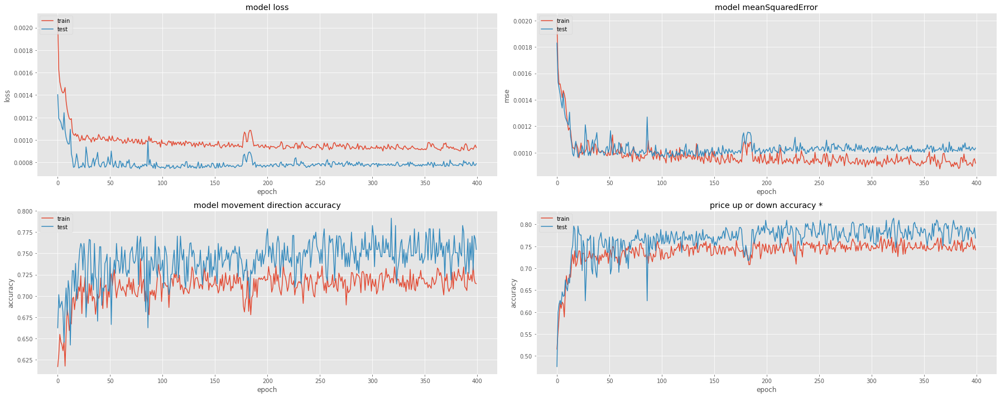

11/11 [==============================] - 0s 7ms/step - loss: 7.8842e-04 - mean_squared_error: 8.3749e-04 - movement_accuracy: 0.7443 - above_or_below_zero_accuracy: 0.7386
Train Score: [0.0008978435071185231, 0.0008993027149699628, 0.7183333039283752, 0.74979168176651]
Test Score: [0.0007884224178269506, 0.0008374916505999863, 0.7443181872367859, 0.7386363744735718]
Cosine similarity -0.97141707
Mean Square Error 0.0007884225
Movement accuracy 0.74404764


In [22]:
plot_train_history(modelo, plot_above_or_below_zero_accuracy=True)

train_score = modelo.evaluate(x=train_X, y=train_y, batch_size=16)
test_score = modelo.evaluate(x=test_X, y=test_y, batch_size=16)
print('Train Score:', train_score)
print('Test Score:', test_score)
#predictions = scaler.inverse_transform(predictions)

#timestep_size = 1./len(features_set)
testPredict = modelo.predict(test_X)

timestep_size = 0.1
original_vectors = [[timestep_size, test_y[i, -1] - test_y[i-1, -1]] for i in range(1, len(test_y))]
prediction_vectors = [[timestep_size, testPredict[i, -1] - test_y[i-1, -1]] for i in range(1, len(test_y))]
cos_similarity = np.mean(keras_cosine_similarity(original_vectors, prediction_vectors))
print('Cosine similarity %s' % cos_similarity)
mse = mean_squared_error(test_y, testPredict).numpy()
print('Mean Square Error %s' % mse)
upDownScore = movement_accuracy(test_y, testPredict).numpy()
print('Movement accuracy %s' % upDownScore)

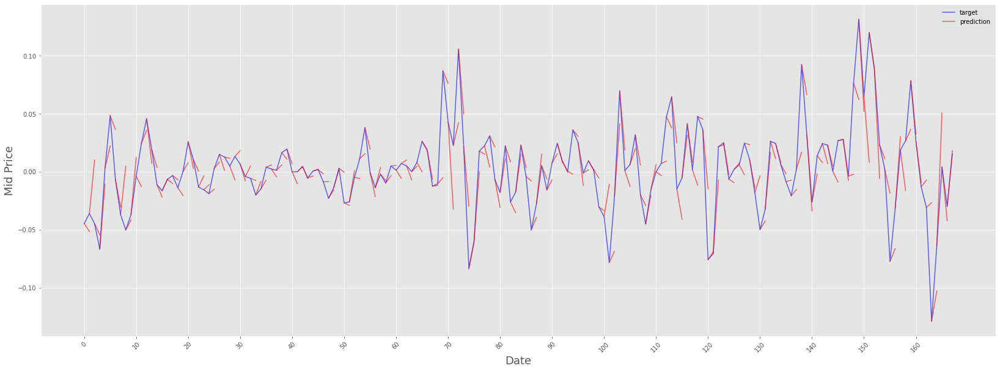

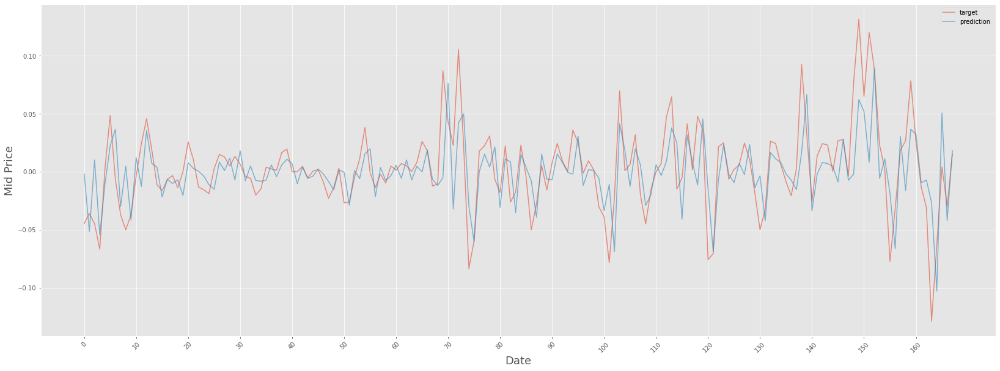

In [23]:
predictions = testPredict
targets_test = test_y[:, -1:].tolist()
# prediction tem um shape (samples, foward_days), entao vamos pegar previsoes de foward_days dias, a cada partir de pontos com intervalo de foward_days
foward_days_predictions = []
for i in range(1, predictions.shape[0], foward_days):
    foward_days_predictions.append(np.array([None]*(i-1) + targets_test[i-1] +
                                            predictions[i].tolist() +
                                            [None]*(predictions.shape[0]-(i+foward_days))))


fig = plot_data([targets_test] + foward_days_predictions, tick=10, legends=['target', 'prediction'],
                colors=['b', 'r'] + ['r']*len(foward_days_predictions), blocking=False)
# 1 day predictions
fig = plot_data([targets_test, predictions[:, 0]], tick=10, legends=['target', 'prediction'], blocking=False)

In [24]:
# tf.keras.backend.clear_session() #limpa modelos e dados anteriores, para evitar vazamento de memoria
from metrics.custom import above_or_below_zero_accuracy, movement_accuracy
from metrics.custom import mean_squared_error, cosine_similarity as custom_cosine_similarity

from sklearn.model_selection import KFold, RepeatedKFold
from shutil import rmtree

def get_model_name(k, n_repeat = None):
    if n_repeat:
        return 'model_'+str(k)+'_'+str(n_repeat)+'.h5'
    return 'model_'+str(k)+'.h5'

def build_and_run_and_show(features, target, shuffle_mask, loss_function, epochs=120, batch_size=32) -> Model:
    save_dir = './tmp_altcoins/saved_models/'
    if os.path.exists(save_dir):
        rmtree(save_dir)

    features_set, labels = to_keras_format(features, target)

    # shuffle_mask = np.arange(len(features_set))
    # np.random.shuffle(shuffle_mask)
    unshuffle_mask = np.zeros(len(shuffle_mask), dtype=int)
    for i in range(len(shuffle_mask)):
        unshuffle_mask[shuffle_mask[i]] = i

    features_set, labels = features_set[shuffle_mask], labels[shuffle_mask]

    
    TEST_MSE = []
    TEST_MOV_ACCURACY = []
    TEST_UPDOWN_ACCURACY = []
    # kf = KFold(n_splits = 5)
    n_repeats = 2
    kf = RepeatedKFold(n_splits = 5, n_repeats = n_repeats, random_state=1337) # random_state fixo para manter reproducibilidade entre chamadas dessa função

    fold_num = 1
    repeat_num = 1
    for train_index, test_index  in kf.split(features_set, labels):
        train_X, test_X = features_set[train_index], features_set[test_index]
        train_y, test_y = labels[train_index], labels[test_index]

        model = build_model(train_X, train_y)
        opt = tf.keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
        model.compile(optimizer=opt, loss=loss_function, metrics=[mean_squared_error, movement_accuracy, above_or_below_zero_accuracy])# 'cosine_similarity', 'mean_squared_error'

        # CREATE CALLBACKS
        best_mse_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mse/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_mean_squared_error:.5f}', 
                                monitor='val_mean_squared_error', verbose=0, save_best_only=True, mode='min')
        best_movAcc_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'mov_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_movement_accuracy', verbose=0, save_best_only=True, mode='max')
        best_above_below_zero_checkpoint = tf.keras.callbacks.ModelCheckpoint(save_dir+'above_or_below_zero_accuracy/'+get_model_name(fold_num, repeat_num),#+'_{epoch:03d}-{val_movement_accuracy:.5f}', 
                                monitor='val_above_or_below_zero_accuracy', verbose=0, save_best_only=True, mode='max')
        checkpoints = [best_mse_checkpoint, best_movAcc_checkpoint, best_above_below_zero_checkpoint]

        print(f'treinando fold {fold_num}, repetição {repeat_num} (400 epochs dá 2min +-)')
        model.fit(train_X, train_y, validation_data=(test_X, test_y), epochs=epochs, batch_size=batch_size, callbacks=checkpoints, verbose=0)

        # PLOT HISTORY
        plot_train_history(model, plot_above_or_below_zero_accuracy=True, figsize=(25,8))

        # LOAD BEST MODEL (for specific metric) to evaluate the performance of the model
        model.load_weights(save_dir+"mse/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MSE.append(results['mean_squared_error'])
        
        model.load_weights(save_dir+"mov_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_MOV_ACCURACY.append(results['movement_accuracy'])

        model.load_weights(save_dir+"above_or_below_zero_accuracy/"+get_model_name(fold_num, repeat_num))
        results = model.evaluate(x=test_X, y=test_y, batch_size=1)
        results = dict(zip(model.metrics_names, results))
        TEST_UPDOWN_ACCURACY.append(results['above_or_below_zero_accuracy'])

        if repeat_num % n_repeats == 0:
            fold_num +=1
            repeat_num = 1
        else:    
            repeat_num += 1        


        tf.keras.backend.clear_session()

    print('\nResults:\n')
    print(f'MeanSquaredError: {TEST_MSE}')
    print(f'MovementDiretionAccuracy: {TEST_MOV_ACCURACY}')
    print(f'AboveOrBellowAccuracy: {TEST_UPDOWN_ACCURACY}')
    print(f'MeanSquaredError mean: {np.mean(TEST_MSE)}')
    print(f'MovementDiretionAccuracy mean: {np.mean(TEST_MOV_ACCURACY)}')
    print(f'AboveOrBellowAccuracy mean: {np.mean(TEST_UPDOWN_ACCURACY)}')

    return

In [25]:
shuffle_mask = np.arange(len(features_set))
np.random.shuffle(shuffle_mask)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


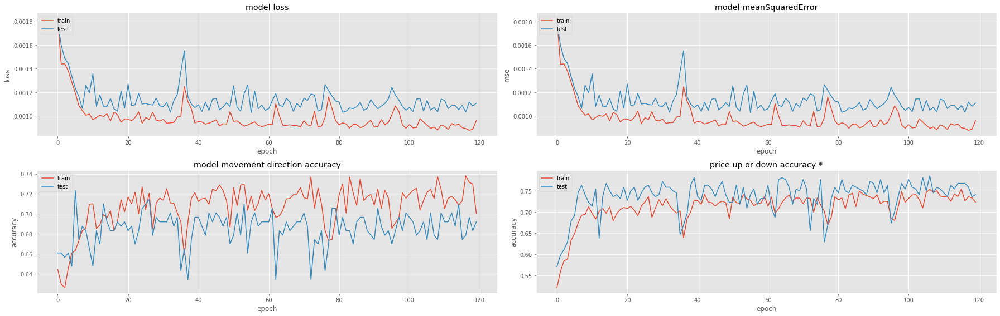

224/224 [==============================] - 1s 5ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7009 - above_or_below_zero_accuracy: 0.7857
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


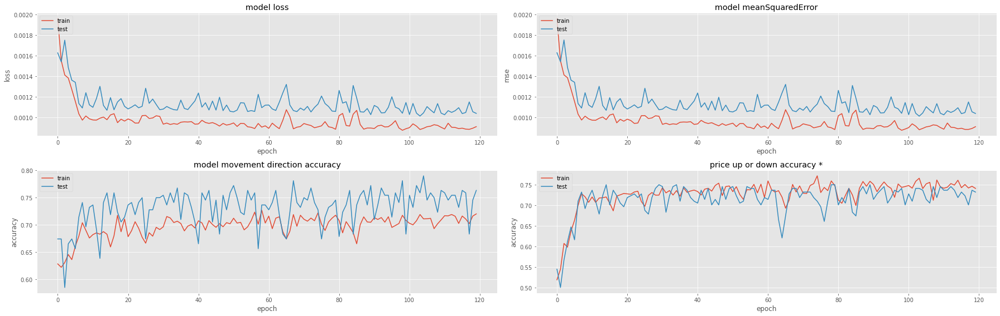

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7589 - above_or_below_zero_accuracy: 0.7500
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


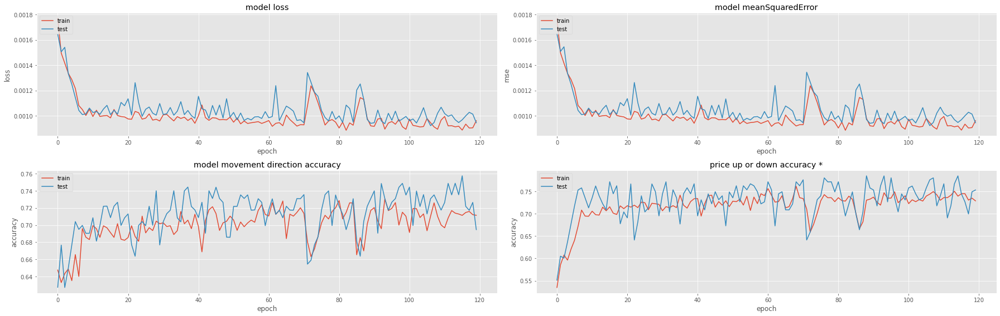

223/223 [==============================] - 1s 6ms/step - loss: 9.7103e-04 - mean_squared_error: 9.7103e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7848
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


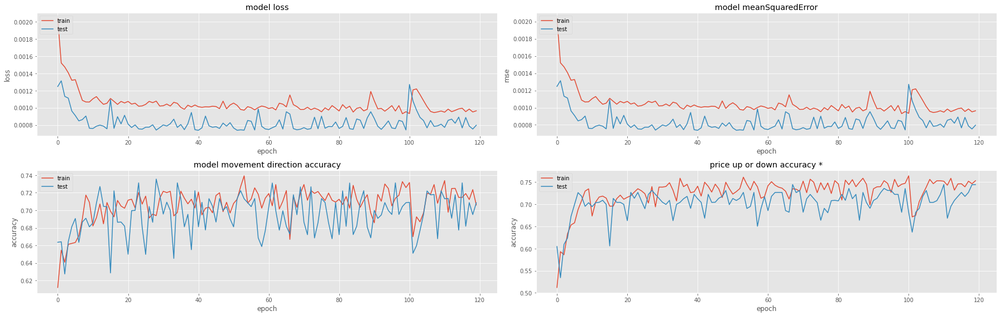

223/223 [==============================] - 1s 6ms/step - loss: 7.5753e-04 - mean_squared_error: 7.5753e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7444
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


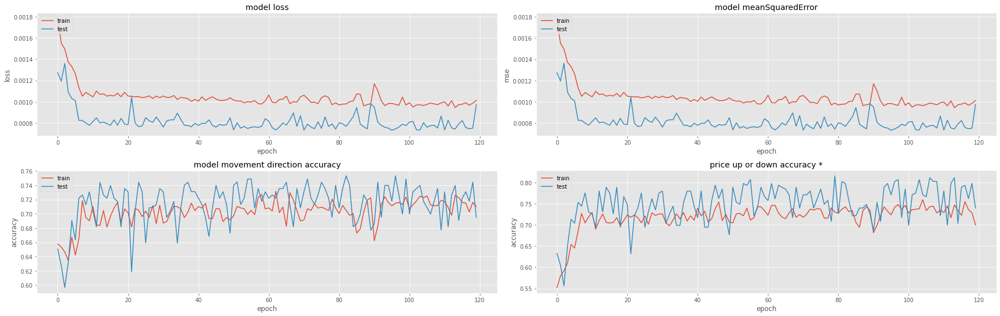

223/223 [==============================] - 1s 6ms/step - loss: 7.4204e-04 - mean_squared_error: 7.4204e-04 - movement_accuracy: 0.7399 - above_or_below_zero_accuracy: 0.8161
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


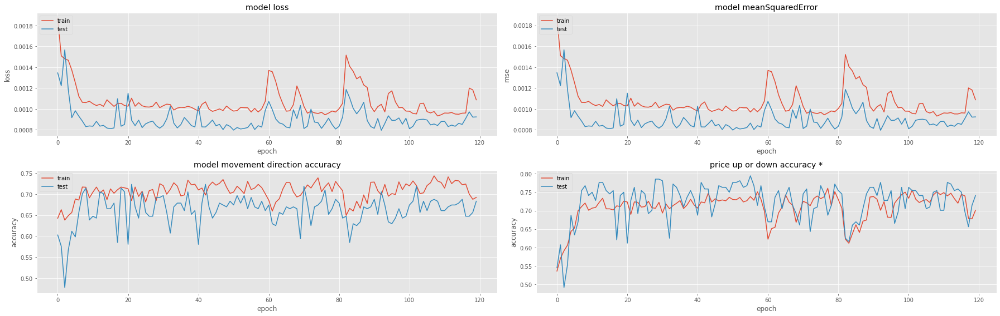

224/224 [==============================] - 1s 6ms/step - loss: 8.6509e-04 - mean_squared_error: 8.6509e-04 - movement_accuracy: 0.6920 - above_or_below_zero_accuracy: 0.7946
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


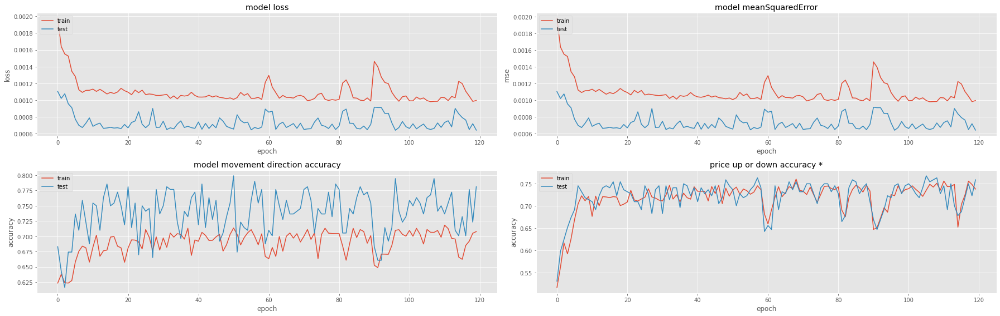

224/224 [==============================] - 1s 6ms/step - loss: 6.6207e-04 - mean_squared_error: 6.6207e-04 - movement_accuracy: 0.7634 - above_or_below_zero_accuracy: 0.7679
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


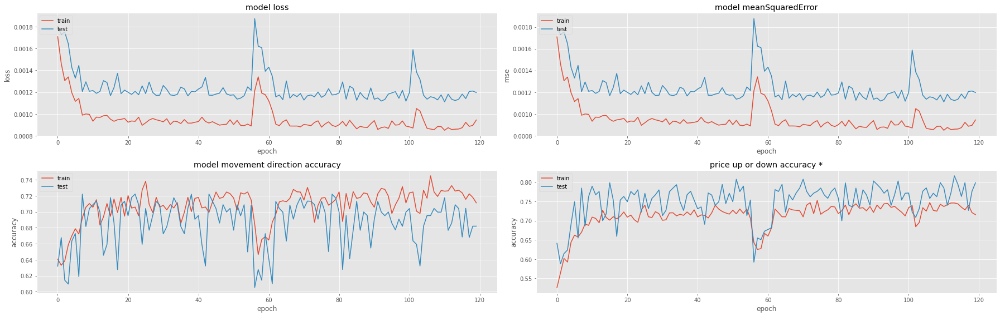

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.8161
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


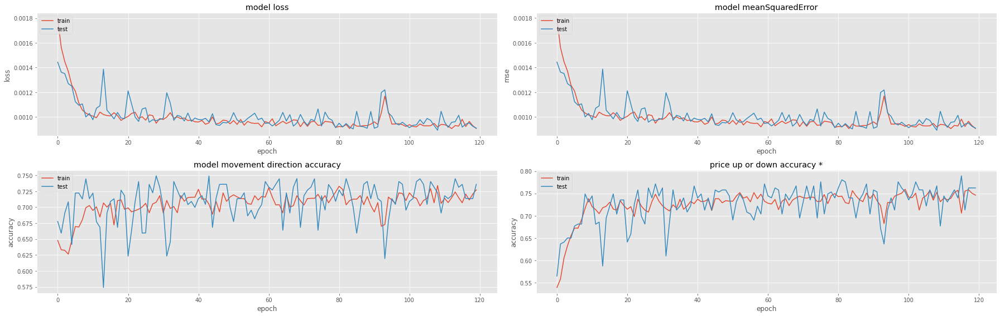

223/223 [==============================] - 1s 6ms/step - loss: 9.1791e-04 - mean_squared_error: 9.1791e-04 - movement_accuracy: 0.7354 - above_or_below_zero_accuracy: 0.7892
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


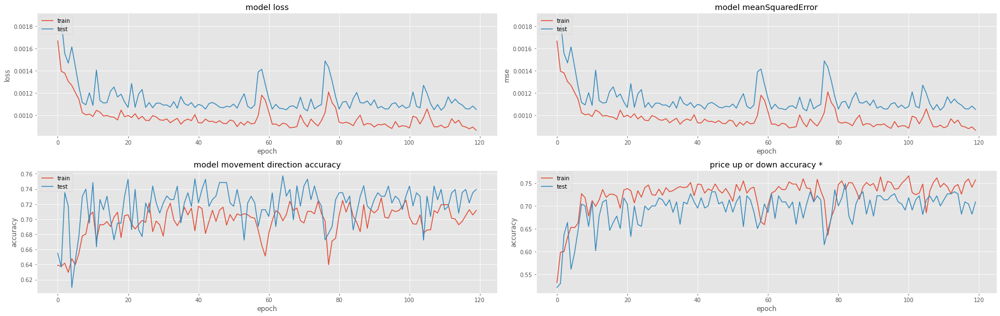

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7489

Results:

MeanSquaredError: [0.001026530866511166, 0.0010118430946022272, 0.000922677805647254, 0.0007381519535556436, 0.0007308422937057912, 0.000796303735114634, 0.0006404580781236291, 0.001111238612793386, 0.0008926523732952774, 0.0010373919503763318]
MovementDiretionAccuracy: [0.7232142686843872, 0.7901785969734192, 0.7578475475311279, 0.7354260087013245, 0.7533632516860962, 0.7232142686843872, 0.7991071343421936, 0.7219731211662292, 0.7488788962364197, 0.7578475475311279]
AboveOrBellowAccuracy: [0.7857142686843872, 0.75, 0.7847533822059631, 0.7443946003913879, 0.8161435127258301, 0.7946428656578064, 0.7678571343421936, 0.8161435127258301, 0.7892376780509949, 0.7488788962364197]
MeanSquaredError mean: 0.0008908090763725341
MovementDiretionAccuracy mean: 0.7511050641536713
AboveOrBellowAccuracy mean: 0.7797765851020813

In [26]:
tf.keras.backend.clear_session()
features = [variation] #+ event_features
target = variation
model_mse = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


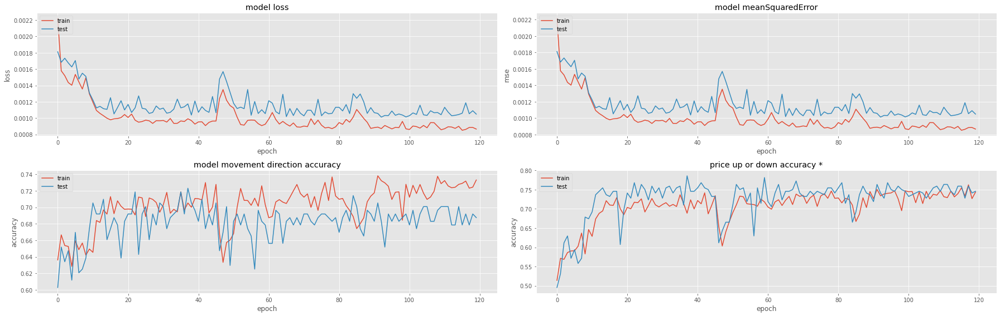

224/224 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7232 - above_or_below_zero_accuracy: 0.7857
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


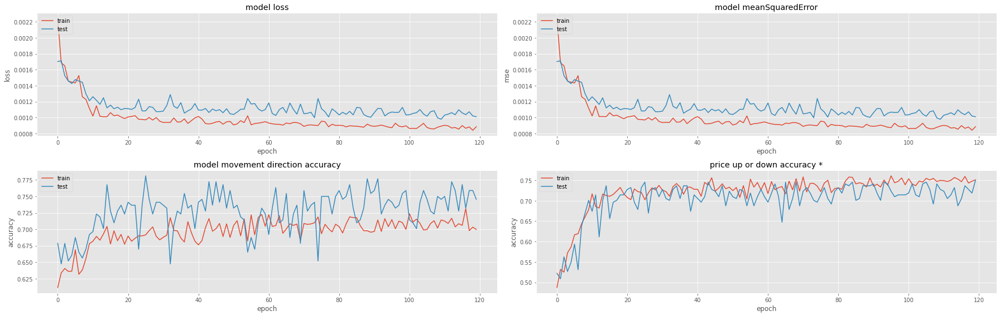

224/224 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.7500
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


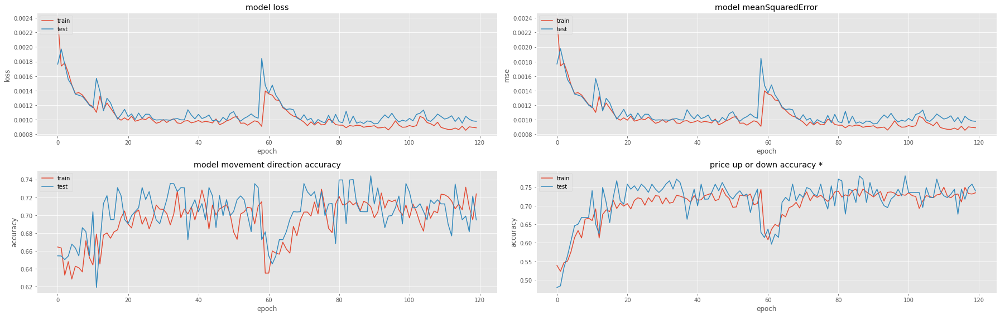

223/223 [==============================] - 1s 6ms/step - loss: 9.7998e-04 - mean_squared_error: 9.7998e-04 - movement_accuracy: 0.7354 - above_or_below_zero_accuracy: 0.7803
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


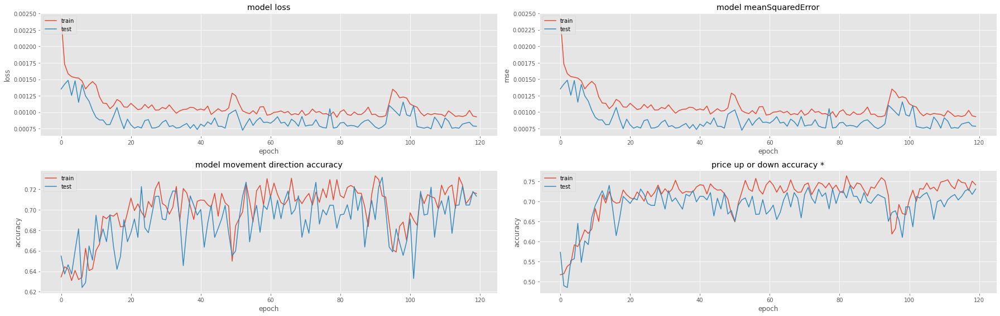

223/223 [==============================] - 1s 6ms/step - loss: 8.1215e-04 - mean_squared_error: 8.1215e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7399
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


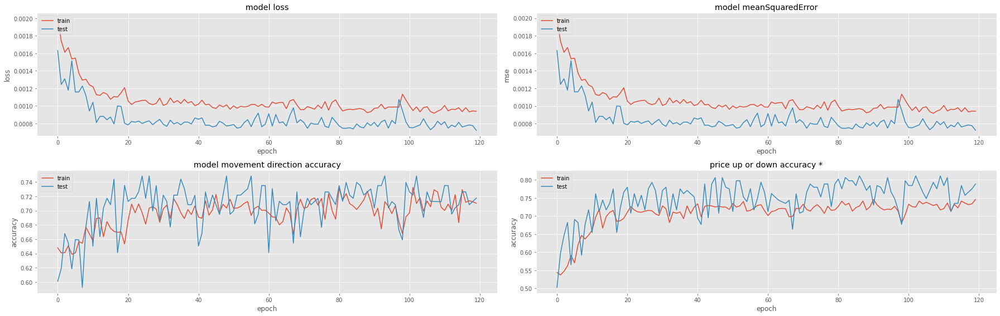

223/223 [==============================] - 1s 6ms/step - loss: 7.6034e-04 - mean_squared_error: 7.6034e-04 - movement_accuracy: 0.7354 - above_or_below_zero_accuracy: 0.8117
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


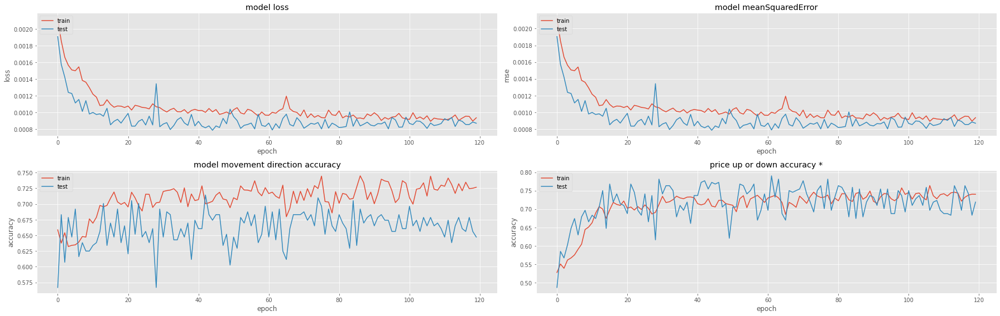

224/224 [==============================] - 2s 7ms/step - loss: 7.8866e-04 - mean_squared_error: 7.8866e-04 - movement_accuracy: 0.6875 - above_or_below_zero_accuracy: 0.7902
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


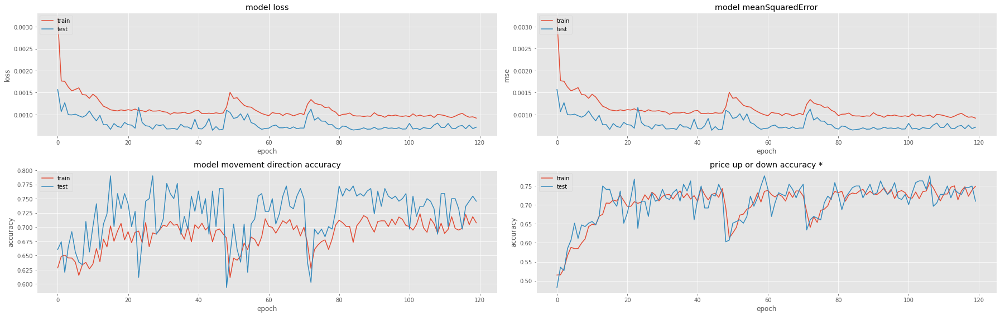

224/224 [==============================] - 1s 6ms/step - loss: 6.8206e-04 - mean_squared_error: 6.8206e-04 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7768
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


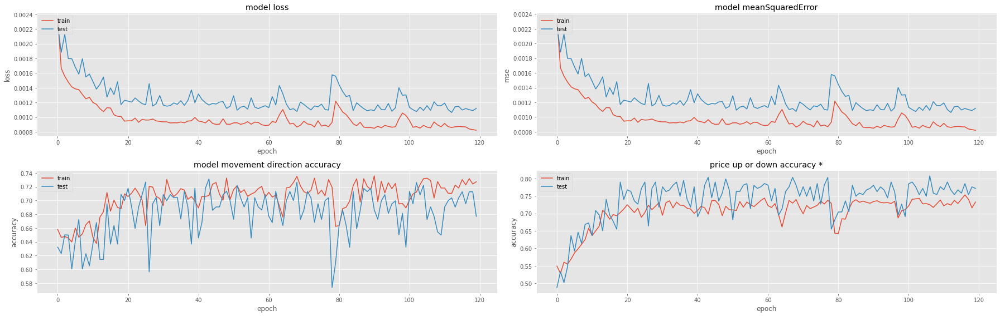

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6906 - above_or_below_zero_accuracy: 0.8072
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


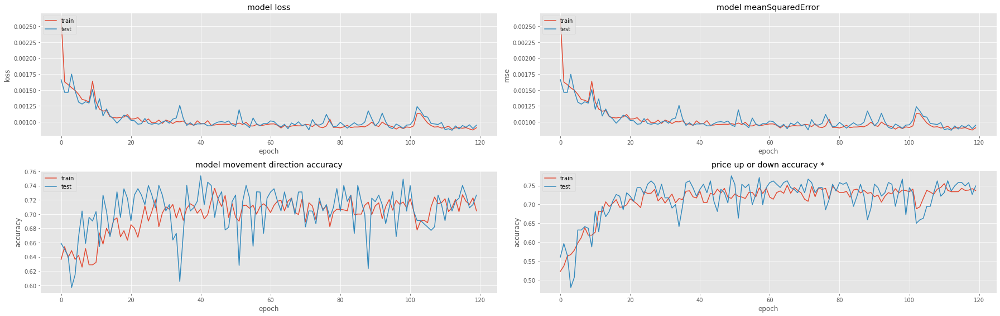

223/223 [==============================] - 1s 6ms/step - loss: 9.5240e-04 - mean_squared_error: 9.5240e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7758
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


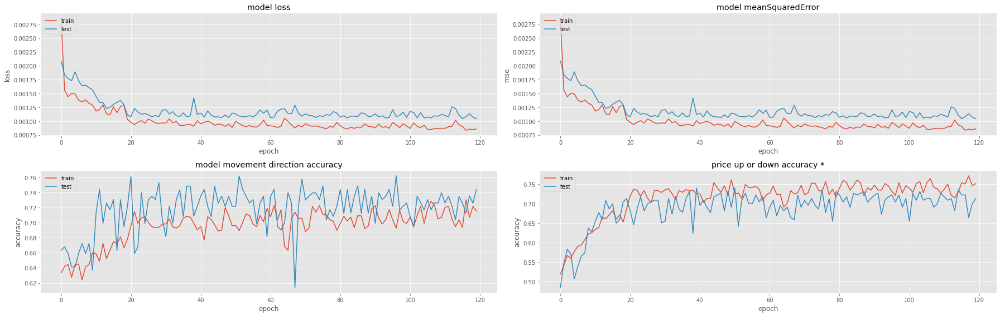

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7399

Results:

MeanSquaredError: [0.0010123123647645116, 0.0009779465617612004, 0.000944135885220021, 0.0007248464971780777, 0.0007225782028399408, 0.0007849651155993342, 0.000640052545350045, 0.0010629385942593217, 0.0008675871067680418, 0.001046232064254582]
MovementDiretionAccuracy: [0.7232142686843872, 0.78125, 0.7443946003913879, 0.7309417128562927, 0.7488788962364197, 0.7142857313156128, 0.7901785969734192, 0.7309417128562927, 0.7533632516860962, 0.7623318433761597]
AboveOrBellowAccuracy: [0.7857142686843872, 0.75, 0.7802690863609314, 0.7399103045463562, 0.8116592168807983, 0.7901785969734192, 0.7767857313156128, 0.8071748614311218, 0.7757847309112549, 0.7399103045463562]
MeanSquaredError mean: 0.0008783594937995076
MovementDiretionAccuracy mean: 0.7479780614376068
AboveOrBellowAccuracy mean: 0.7757387101650238


In [27]:
tf.keras.backend.clear_session()
features = [variation, volume_variation] #+ event_features
target = variation
model_mse = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


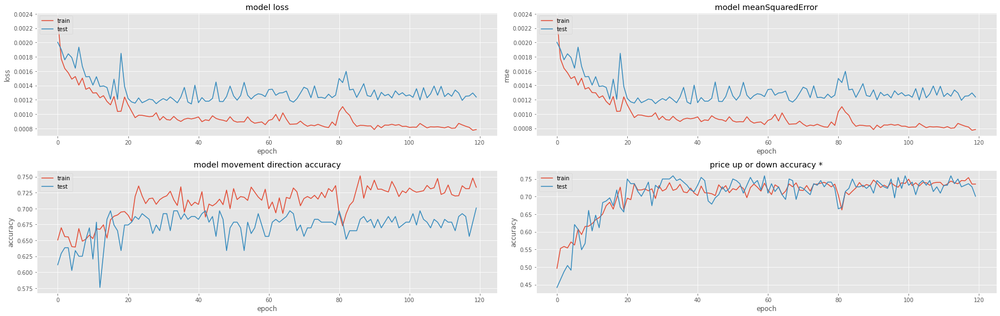

224/224 [==============================] - 1s 5ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.6964 - above_or_below_zero_accuracy: 0.7589
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


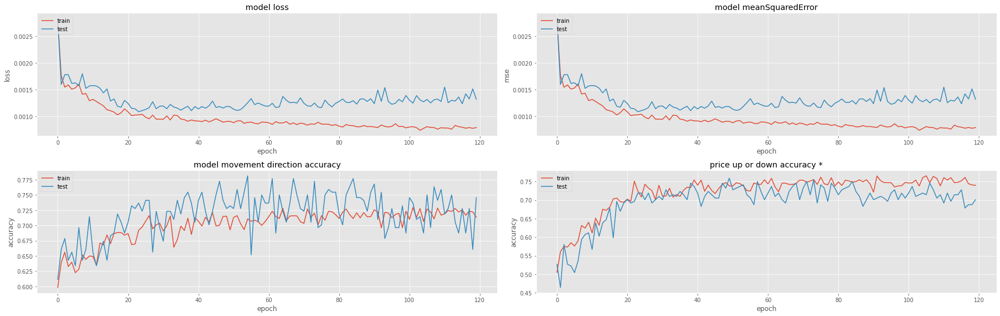

224/224 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7589
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


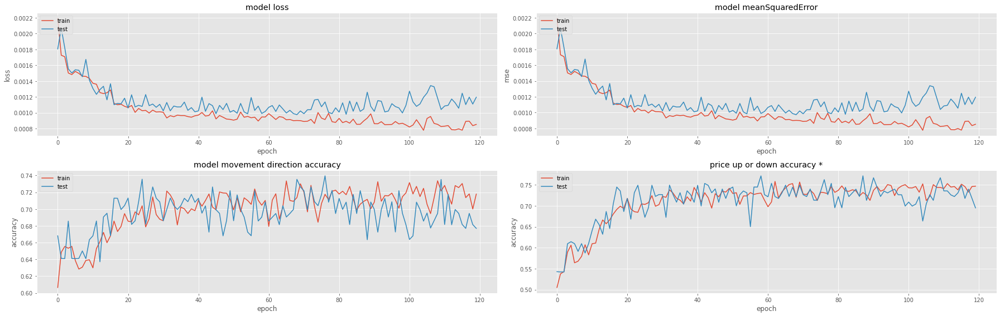

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7040 - above_or_below_zero_accuracy: 0.7713
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


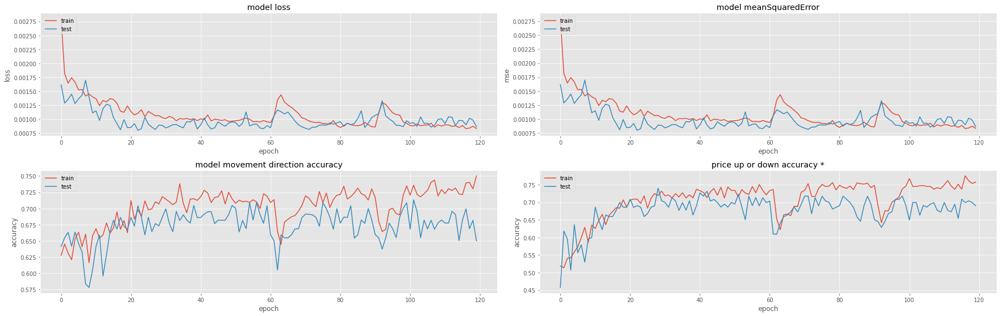

223/223 [==============================] - 1s 6ms/step - loss: 8.9416e-04 - mean_squared_error: 8.9416e-04 - movement_accuracy: 0.6726 - above_or_below_zero_accuracy: 0.7399
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


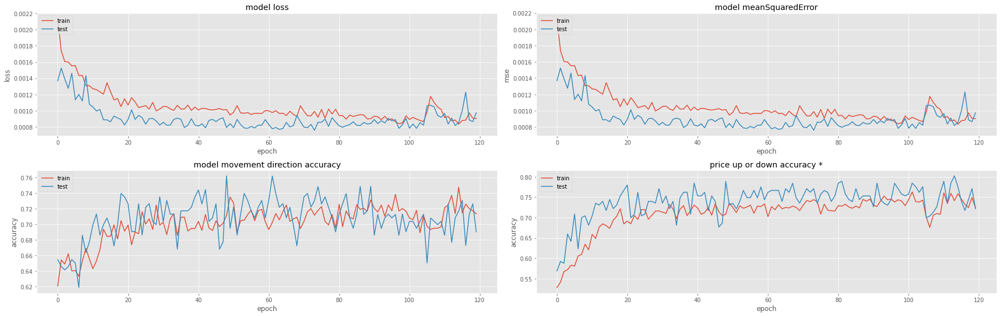

223/223 [==============================] - 1s 7ms/step - loss: 8.1609e-04 - mean_squared_error: 8.1609e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.8027
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


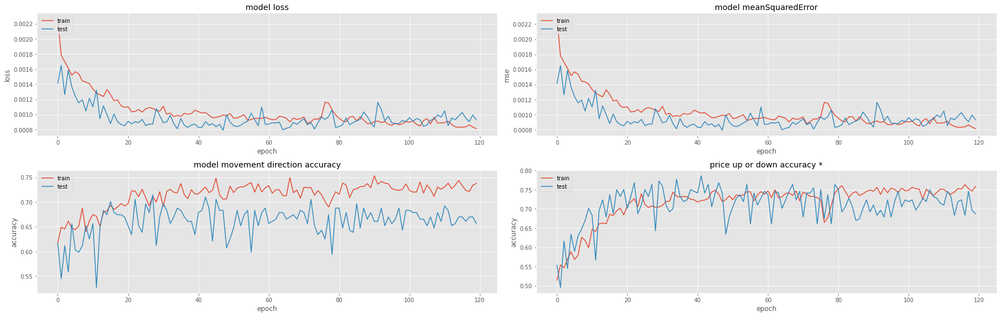

224/224 [==============================] - 2s 7ms/step - loss: 8.2913e-04 - mean_squared_error: 8.2913e-04 - movement_accuracy: 0.6830 - above_or_below_zero_accuracy: 0.7857
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


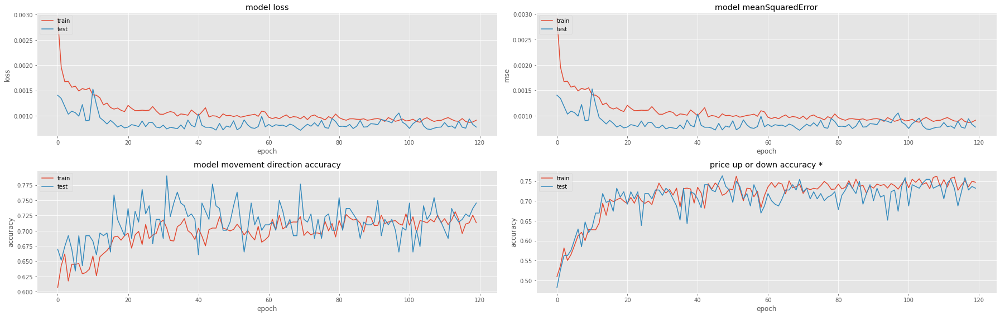

224/224 [==============================] - 1s 6ms/step - loss: 7.2001e-04 - mean_squared_error: 7.2001e-04 - movement_accuracy: 0.7009 - above_or_below_zero_accuracy: 0.7634
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


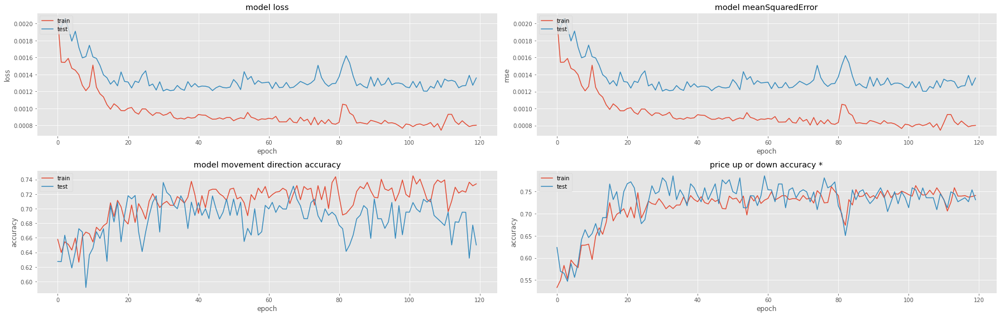

223/223 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7040 - above_or_below_zero_accuracy: 0.7848
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


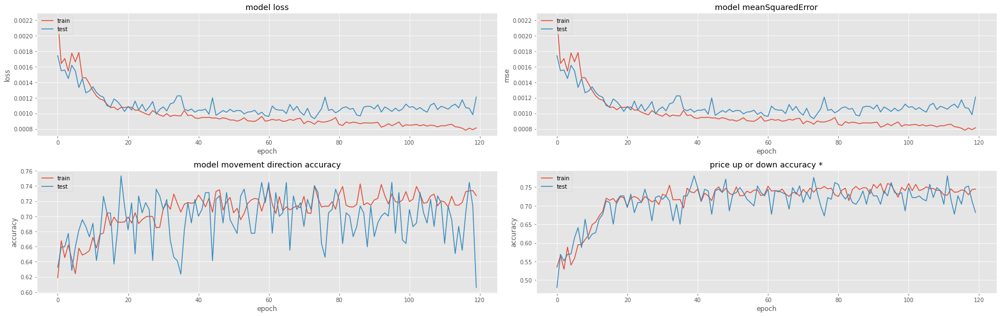

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7803
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


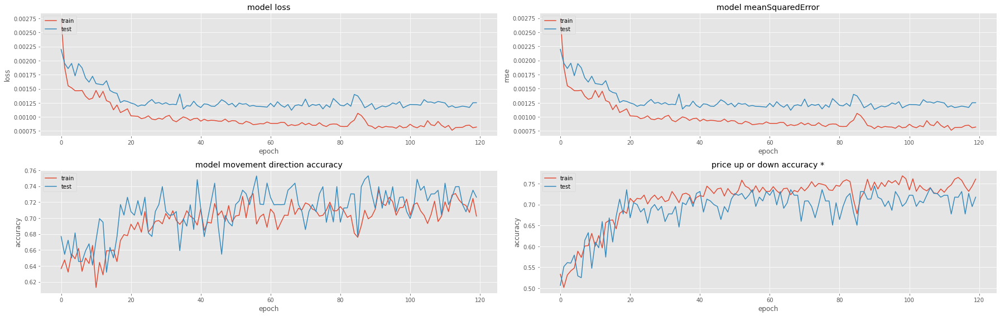

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7444

Results:

MeanSquaredError: [0.0011407603742554784, 0.0010867612436413765, 0.0009750864701345563, 0.0008018644293770194, 0.0007573461043648422, 0.0007904518279246986, 0.0007129511795938015, 0.0012024922762066126, 0.0009308346197940409, 0.0011183753376826644]
MovementDiretionAccuracy: [0.7008928656578064, 0.78125, 0.7399103045463562, 0.713004469871521, 0.7623318433761597, 0.7142857313156128, 0.7901785969734192, 0.7354260087013245, 0.7533632516860962, 0.7533632516860962]
AboveOrBellowAccuracy: [0.7589285969734192, 0.7589285969734192, 0.7713004350662231, 0.7399103045463562, 0.8026905655860901, 0.7857142686843872, 0.7633928656578064, 0.7847533822059631, 0.7802690863609314, 0.7443946003913879]
MeanSquaredError mean: 0.000951692386297509
MovementDiretionAccuracy mean: 0.7444006323814392
AboveOrBellowAccuracy mean: 0.76902827024

In [28]:
features = [variation, volume_variation] + event_votes_features + event_confidence_features
target = variation
model_events = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


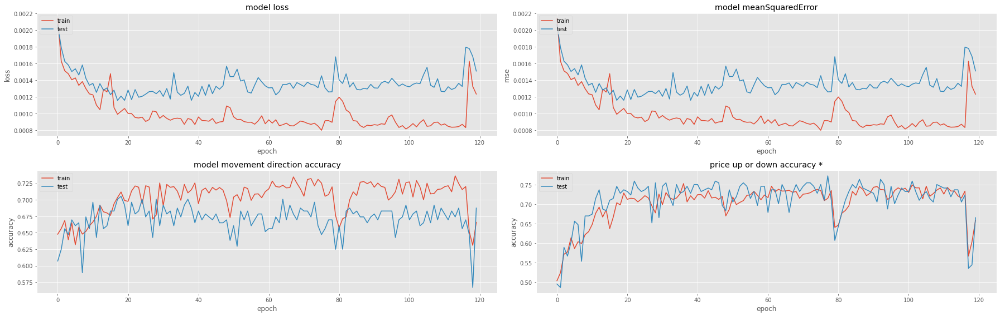

224/224 [==============================] - 1s 5ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.6696 - above_or_below_zero_accuracy: 0.7723
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


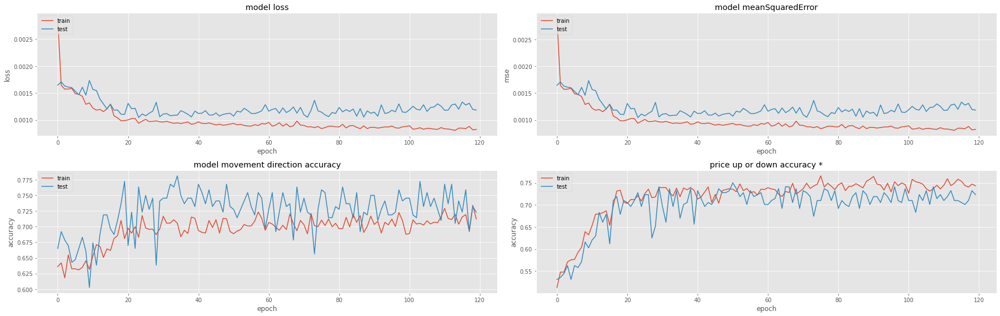

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7277 - above_or_below_zero_accuracy: 0.7500
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


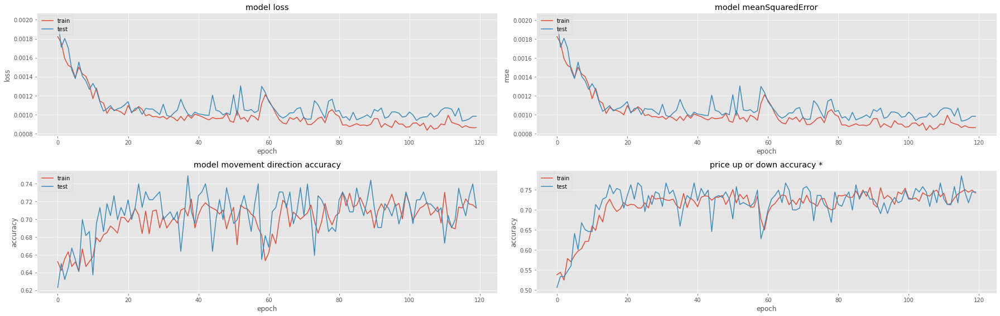

223/223 [==============================] - 2s 7ms/step - loss: 9.3101e-04 - mean_squared_error: 9.3101e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7848
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


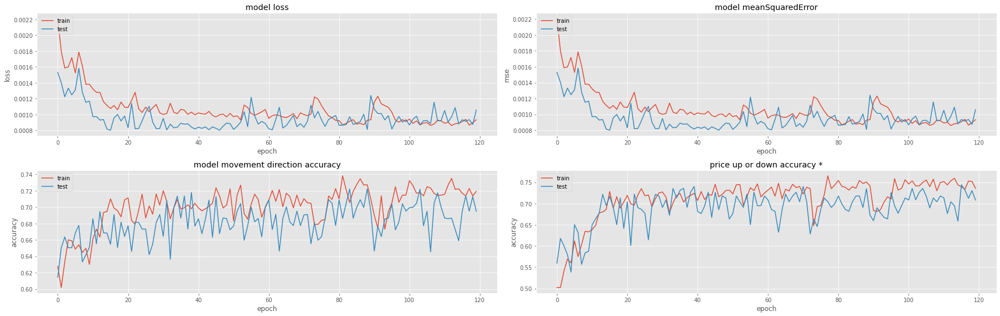

223/223 [==============================] - 2s 7ms/step - loss: 9.3386e-04 - mean_squared_error: 9.3386e-04 - movement_accuracy: 0.6951 - above_or_below_zero_accuracy: 0.7444
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


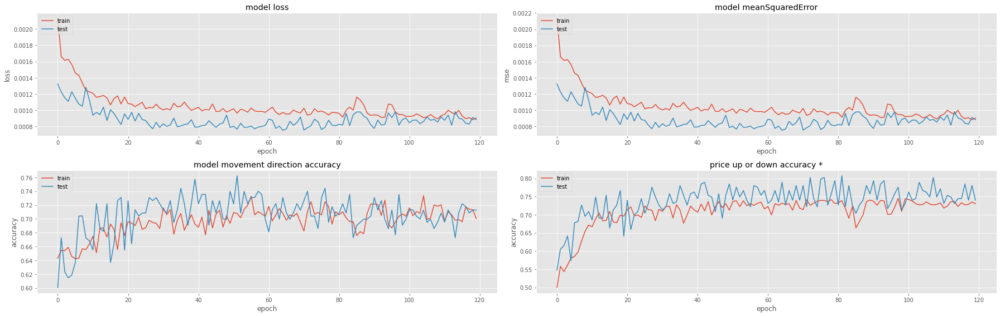

223/223 [==============================] - 1s 6ms/step - loss: 8.1684e-04 - mean_squared_error: 8.1684e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.8072
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


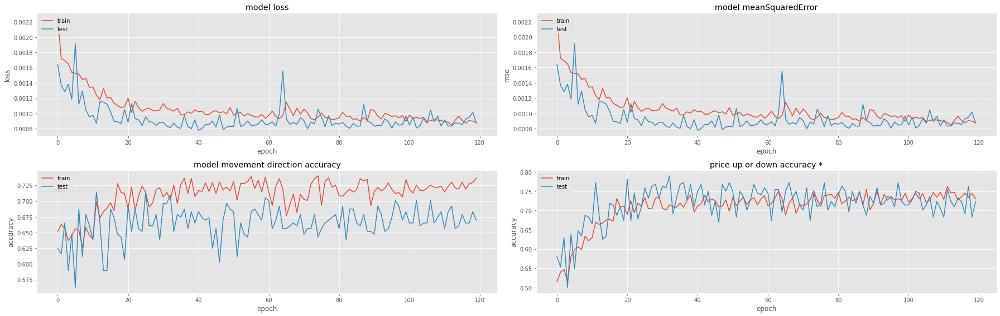

224/224 [==============================] - 1s 6ms/step - loss: 8.1459e-04 - mean_squared_error: 8.1459e-04 - movement_accuracy: 0.7098 - above_or_below_zero_accuracy: 0.7902
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


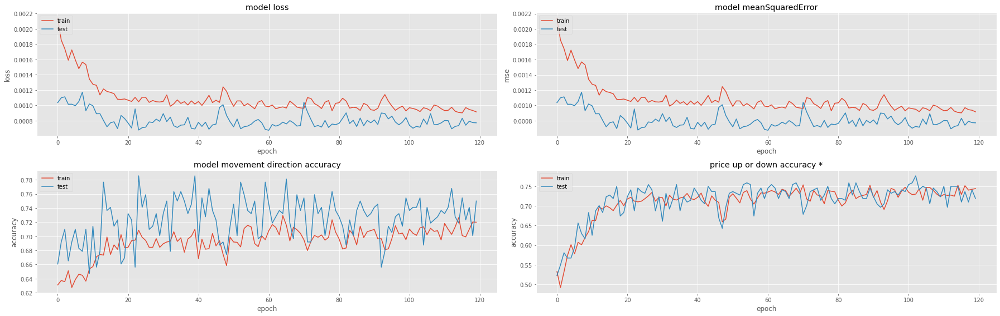

224/224 [==============================] - 1s 6ms/step - loss: 7.2544e-04 - mean_squared_error: 7.2544e-04 - movement_accuracy: 0.7411 - above_or_below_zero_accuracy: 0.7768
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


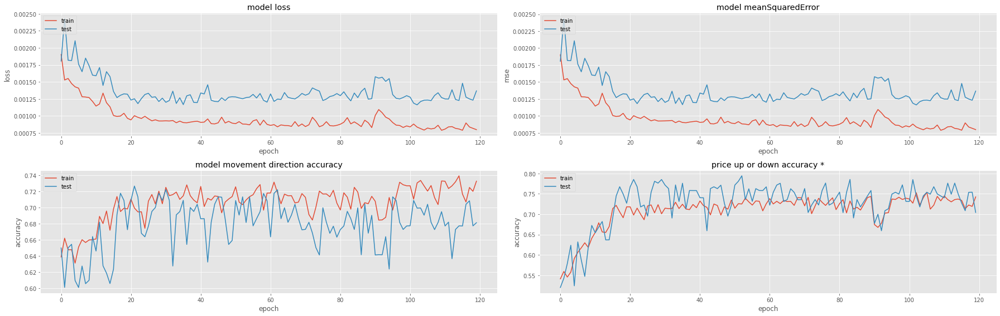

223/223 [==============================] - 1s 6ms/step - loss: 0.0013 - mean_squared_error: 0.0013 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7937
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


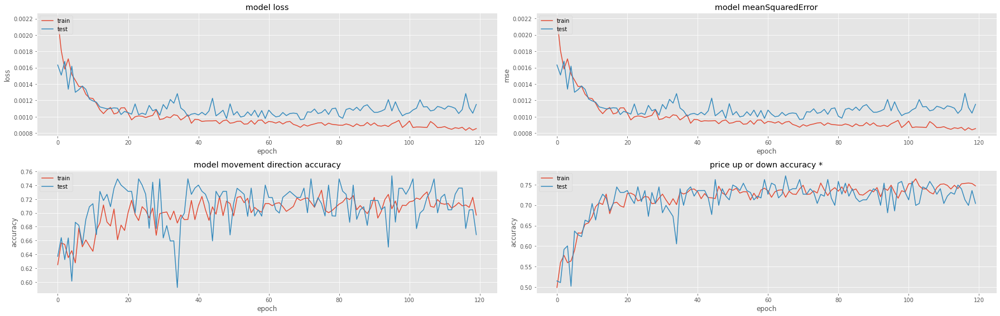

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7265 - above_or_below_zero_accuracy: 0.7713
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


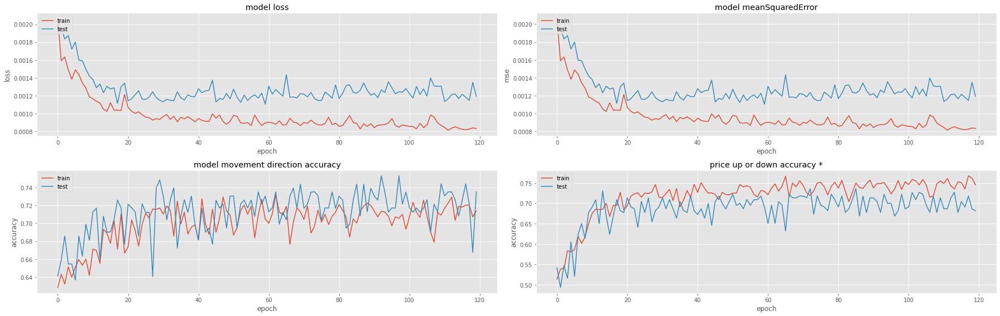

223/223 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.7444 - above_or_below_zero_accuracy: 0.7354

Results:

MeanSquaredError: [0.001158853410743177, 0.001044750795699656, 0.000931014190427959, 0.0008014775230549276, 0.0007519582286477089, 0.0007784644258208573, 0.0006744098500348628, 0.001163229113444686, 0.000964424922131002, 0.0011050594039261341]
MovementDiretionAccuracy: [0.7053571343421936, 0.78125, 0.7488788962364197, 0.7219731211662292, 0.7623318433761597, 0.7142857313156128, 0.7857142686843872, 0.726457417011261, 0.7533632516860962, 0.7533632516860962]
AboveOrBellowAccuracy: [0.7723214030265808, 0.75, 0.7847533822059631, 0.7443946003913879, 0.8071748614311218, 0.7901785969734192, 0.7767857313156128, 0.7937219738960266, 0.7713004350662231, 0.7354260087013245]
MeanSquaredError mean: 0.000937364186393097
MovementDiretionAccuracy mean: 0.7452974915504456
AboveOrBellowAccuracy mean: 0.772605699300766


In [29]:
features = [variation, volume_variation] + event_votes_features
target = variation
model_events = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


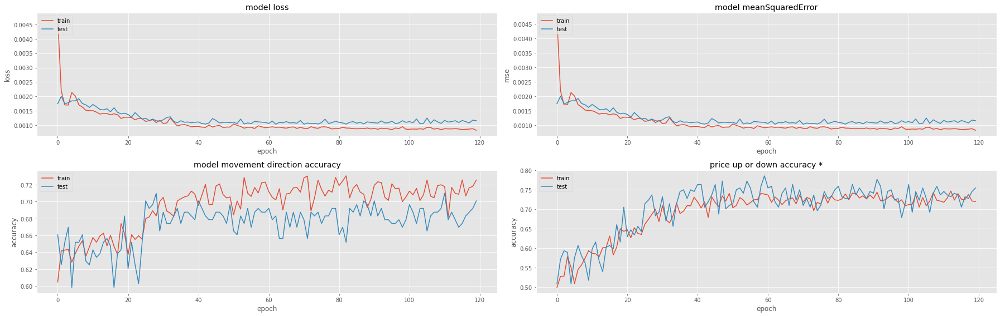

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6875 - above_or_below_zero_accuracy: 0.7857
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


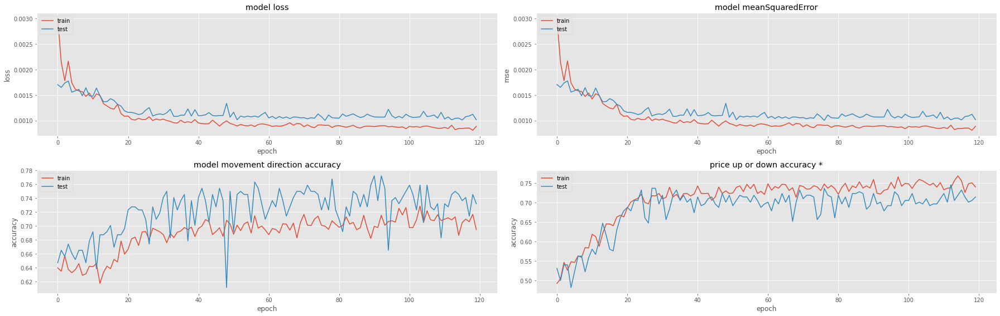

224/224 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7455 - above_or_below_zero_accuracy: 0.7455
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


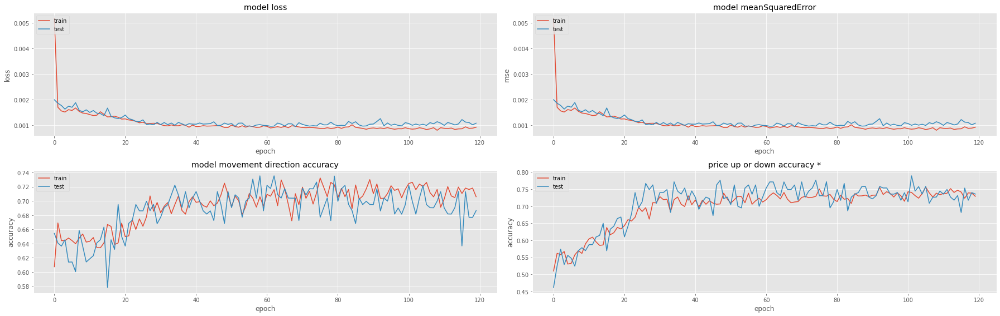

223/223 [==============================] - 1s 6ms/step - loss: 9.9928e-04 - mean_squared_error: 9.9928e-04 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7892
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


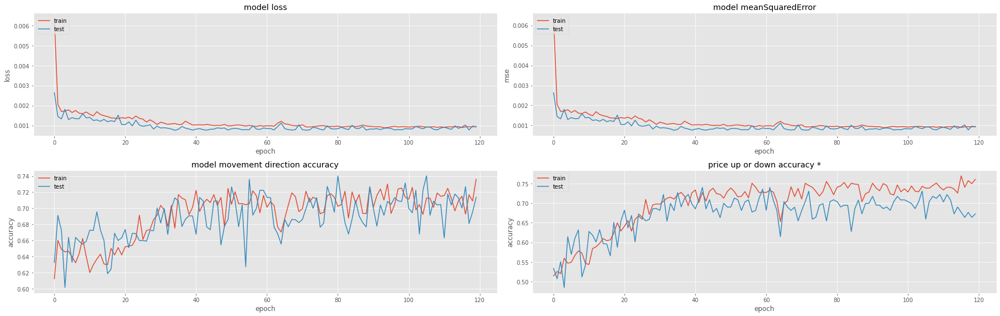

223/223 [==============================] - 1s 6ms/step - loss: 7.8788e-04 - mean_squared_error: 7.8788e-04 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7399
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


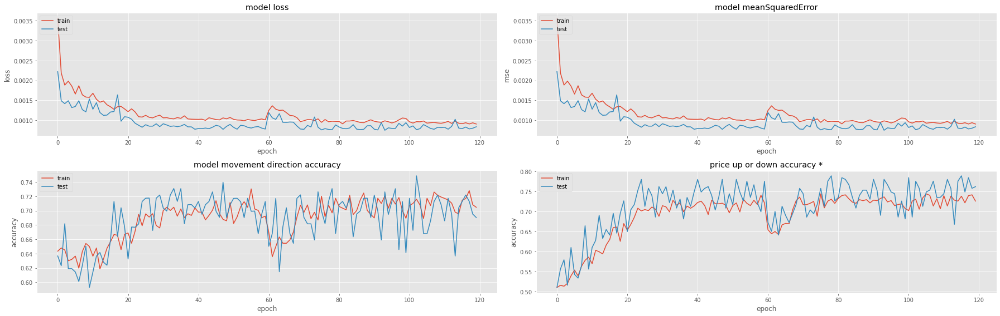

223/223 [==============================] - 1s 6ms/step - loss: 7.6148e-04 - mean_squared_error: 7.6148e-04 - movement_accuracy: 0.7309 - above_or_below_zero_accuracy: 0.7892
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


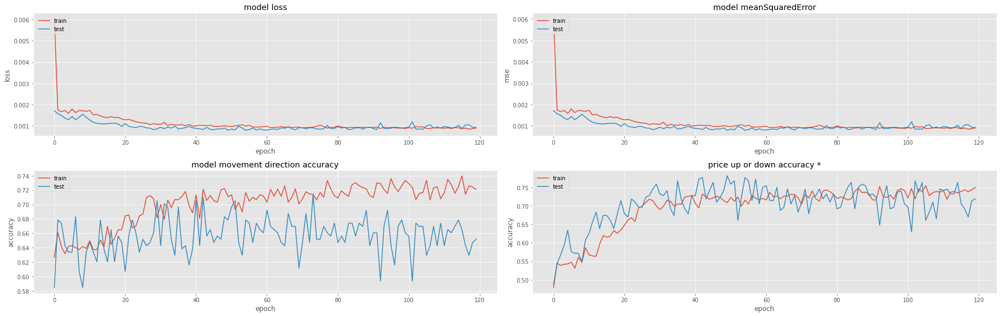

224/224 [==============================] - 1s 6ms/step - loss: 7.9740e-04 - mean_squared_error: 7.9740e-04 - movement_accuracy: 0.6786 - above_or_below_zero_accuracy: 0.7812
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


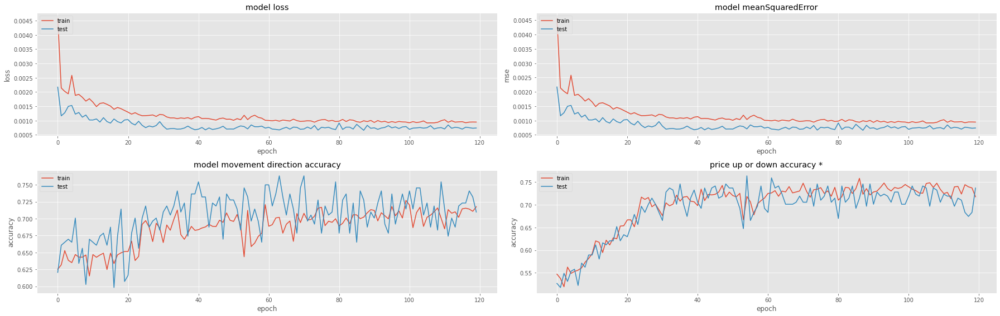

224/224 [==============================] - 1s 6ms/step - loss: 7.0977e-04 - mean_squared_error: 7.0977e-04 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7634
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


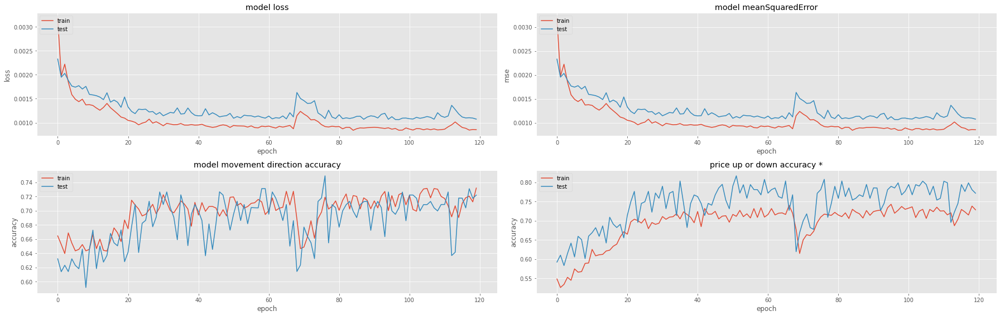

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.8161
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


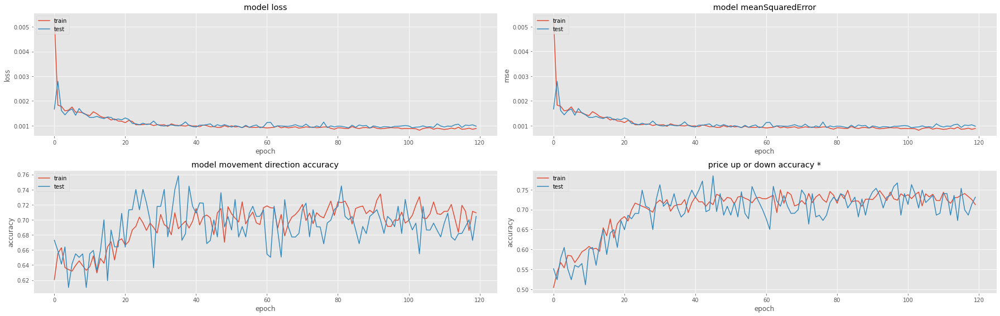

223/223 [==============================] - 1s 6ms/step - loss: 9.5286e-04 - mean_squared_error: 9.5286e-04 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7848
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


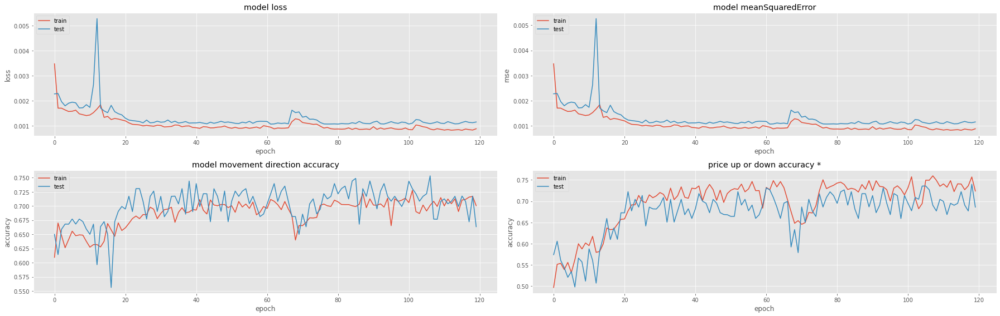

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7399

Results:

MeanSquaredError: [0.0010316066909581423, 0.0010013781720772386, 0.0009491507080383599, 0.0007588767330162227, 0.0007467205286957324, 0.0007960539660416543, 0.000661396246869117, 0.0010641347616910934, 0.0009039987926371396, 0.0010703976731747389]
MovementDiretionAccuracy: [0.7098214030265808, 0.7723214030265808, 0.7354260087013245, 0.7399103045463562, 0.7488788962364197, 0.7142857313156128, 0.7633928656578064, 0.7488788962364197, 0.7578475475311279, 0.7533632516860962]
AboveOrBellowAccuracy: [0.7857142686843872, 0.7455357313156128, 0.7892376780509949, 0.7399103045463562, 0.7892376780509949, 0.78125, 0.7633928656578064, 0.8161435127258301, 0.7847533822059631, 0.7399103045463562]
MeanSquaredError mean: 0.0008983714273199439
MovementDiretionAccuracy mean: 0.7444126307964325
AboveOrBellowAccuracy mean: 0.7735085725

In [30]:
features = [variation, volume_variation, tweet_variation]
target = variation
model_events = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


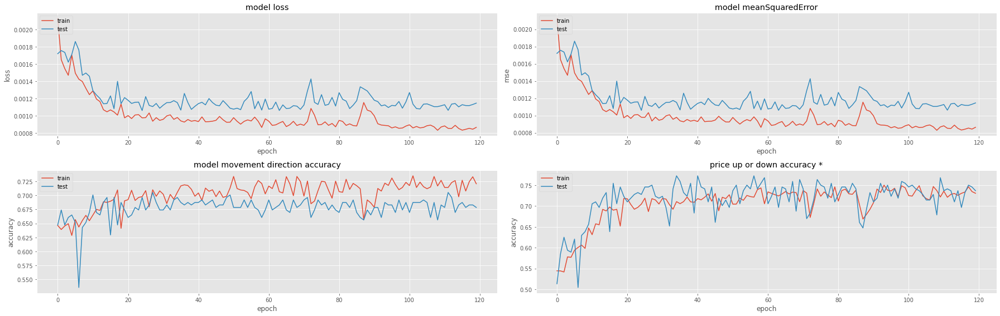

224/224 [==============================] - 1s 6ms/step - loss: 0.0012 - mean_squared_error: 0.0012 - movement_accuracy: 0.6964 - above_or_below_zero_accuracy: 0.7723
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


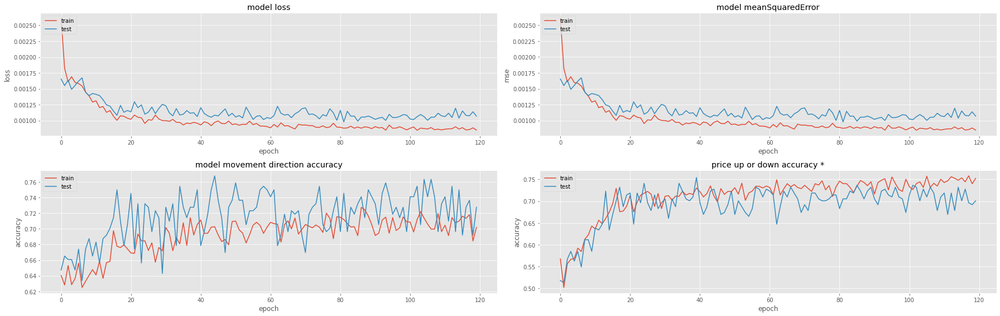

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7500 - above_or_below_zero_accuracy: 0.7545
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


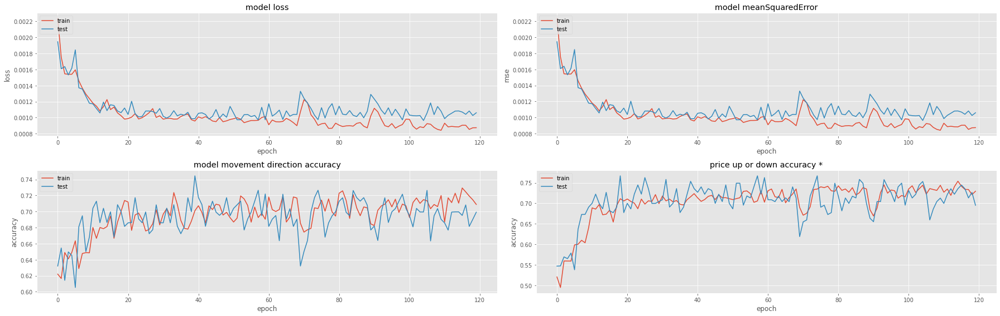

223/223 [==============================] - 1s 7ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7668
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


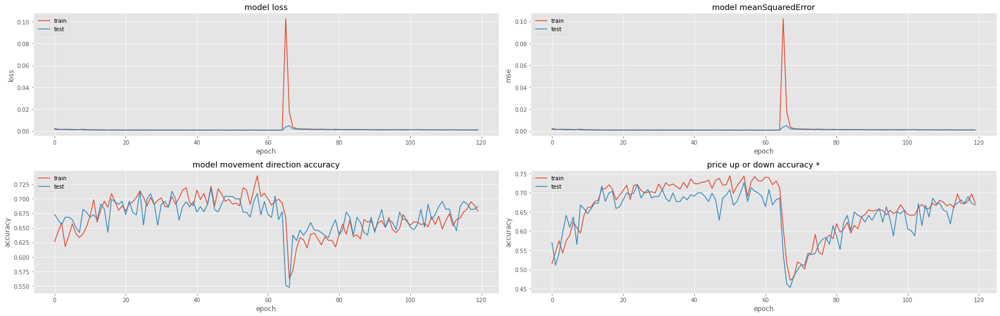

223/223 [==============================] - 1s 6ms/step - loss: 8.3108e-04 - mean_squared_error: 8.3108e-04 - movement_accuracy: 0.6771 - above_or_below_zero_accuracy: 0.7265
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


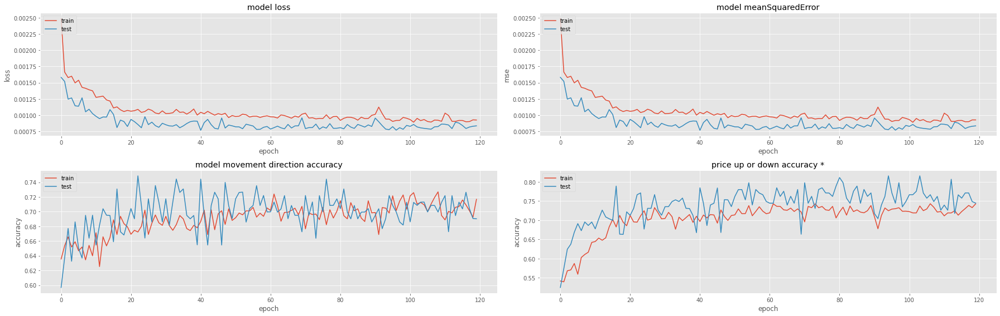

223/223 [==============================] - 2s 7ms/step - loss: 7.7706e-04 - mean_squared_error: 7.7706e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.8161
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


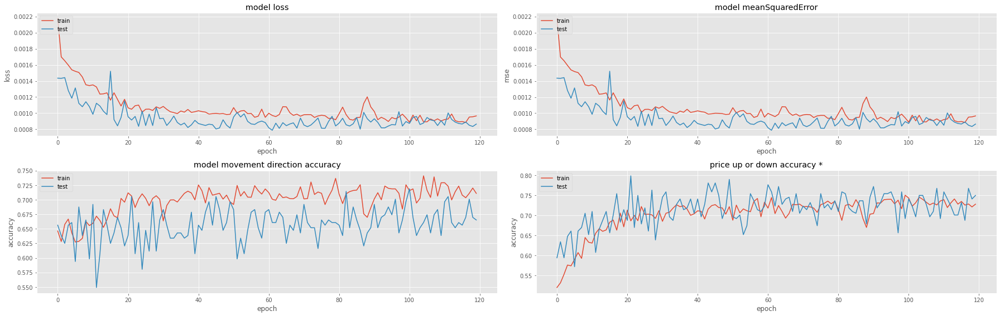

224/224 [==============================] - 1s 6ms/step - loss: 9.1492e-04 - mean_squared_error: 9.1492e-04 - movement_accuracy: 0.7054 - above_or_below_zero_accuracy: 0.7991
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


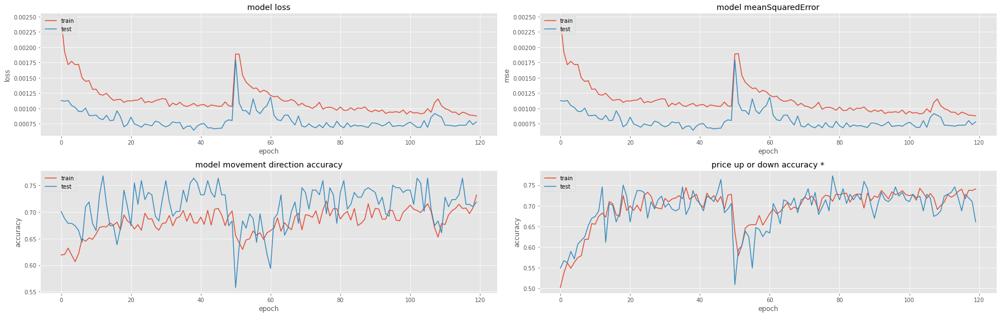

224/224 [==============================] - 1s 6ms/step - loss: 6.9004e-04 - mean_squared_error: 6.9004e-04 - movement_accuracy: 0.7321 - above_or_below_zero_accuracy: 0.7723
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


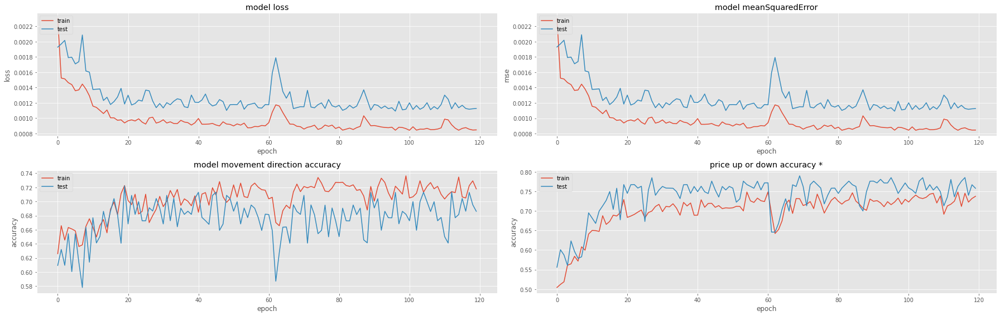

223/223 [==============================] - 2s 7ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6816 - above_or_below_zero_accuracy: 0.7892
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


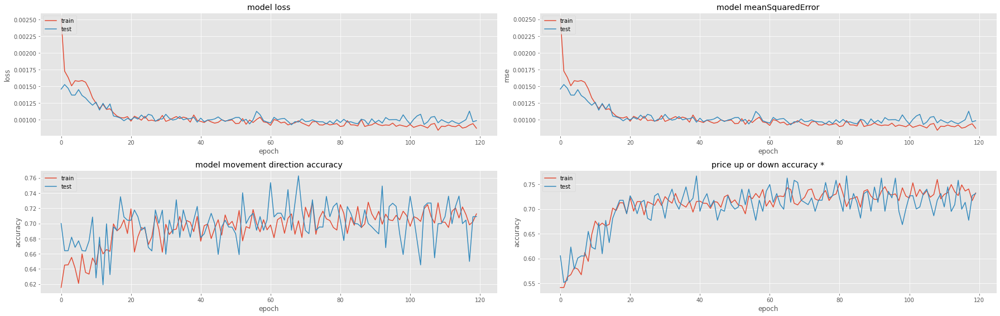

223/223 [==============================] - 1s 6ms/step - loss: 9.6624e-04 - mean_squared_error: 9.6624e-04 - movement_accuracy: 0.7220 - above_or_below_zero_accuracy: 0.7668
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


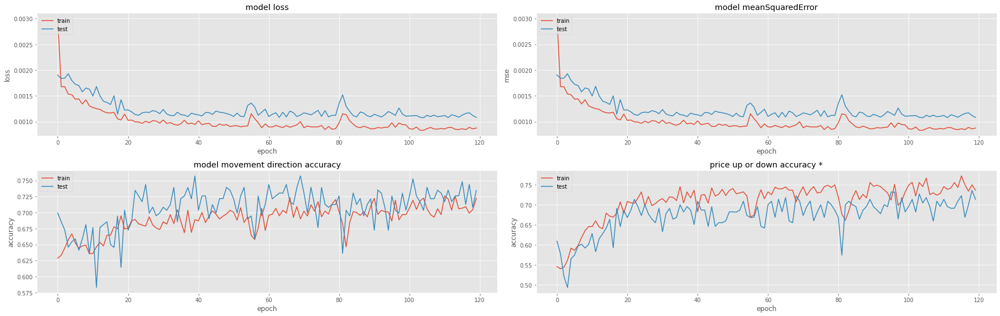

223/223 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7085 - above_or_below_zero_accuracy: 0.7354

Results:

MeanSquaredError: [0.0010596292559057474, 0.0009785128058865666, 0.0009639994241297245, 0.0007498654304072261, 0.0007665934390388429, 0.0007881874917075038, 0.0006432273657992482, 0.001091605518013239, 0.0009266699198633432, 0.0010743780294433236]
MovementDiretionAccuracy: [0.7053571343421936, 0.7678571343421936, 0.7443946003913879, 0.7174887657165527, 0.7488788962364197, 0.71875, 0.7678571343421936, 0.7219731211662292, 0.7623318433761597, 0.7578475475311279]
AboveOrBellowAccuracy: [0.7723214030265808, 0.7544642686843872, 0.7668161392211914, 0.726457417011261, 0.8161435127258301, 0.7991071343421936, 0.7723214030265808, 0.7892376780509949, 0.7668161392211914, 0.7354260087013245]
MeanSquaredError mean: 0.0009042668680194765
MovementDiretionAccuracy mean: 0.7412736177444458
AboveOrBellowAccuracy mean: 0.76991111040

In [31]:
features = [variation, volume_variation, google_trends_variation]
target = variation
model_events = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

treinando fold 1, repetição 1 (400 epochs dá 2min +-)


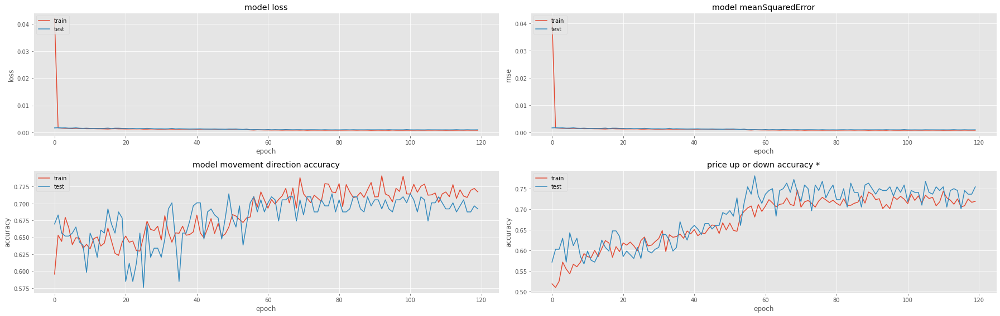

224/224 [==============================] - 1s 5ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.6875 - above_or_below_zero_accuracy: 0.7812
treinando fold 1, repetição 2 (400 epochs dá 2min +-)


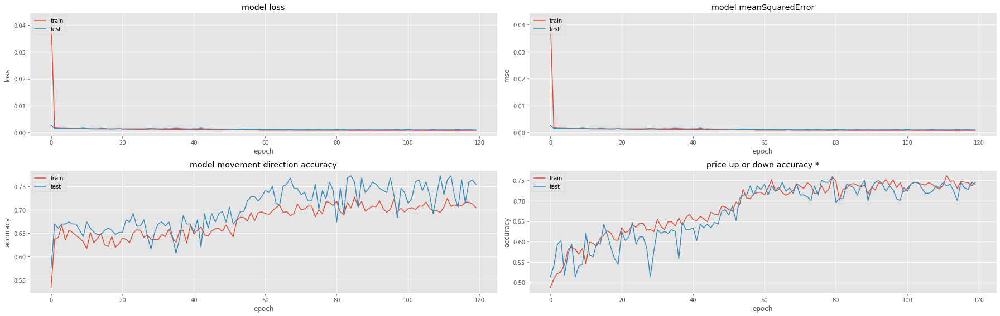

224/224 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7411 - above_or_below_zero_accuracy: 0.7589
treinando fold 2, repetição 1 (400 epochs dá 2min +-)


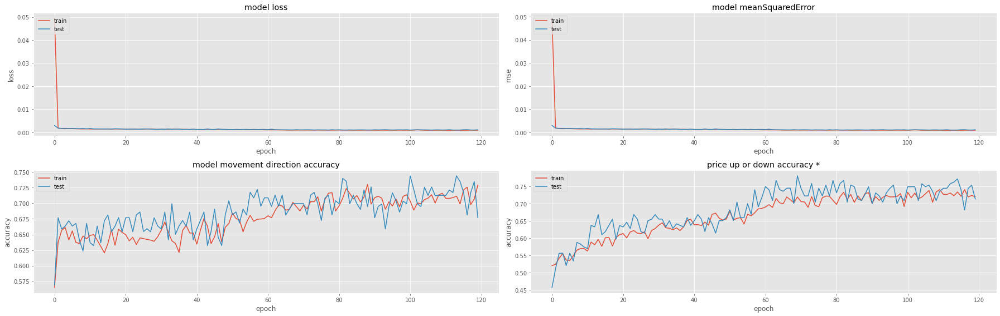

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.6996 - above_or_below_zero_accuracy: 0.7803
treinando fold 2, repetição 2 (400 epochs dá 2min +-)


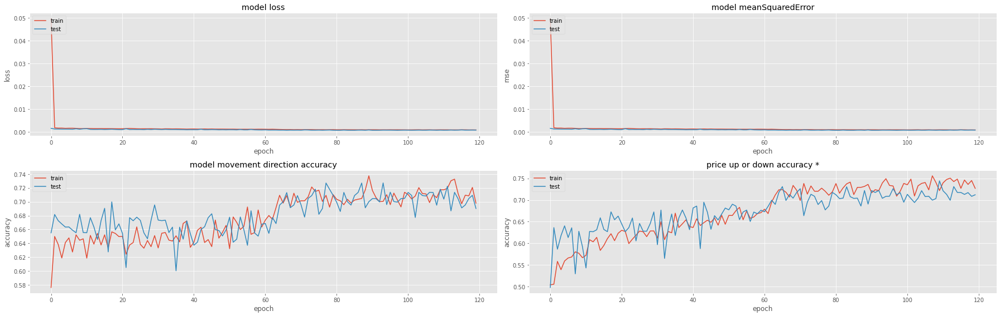

223/223 [==============================] - 1s 6ms/step - loss: 8.1937e-04 - mean_squared_error: 8.1937e-04 - movement_accuracy: 0.7175 - above_or_below_zero_accuracy: 0.7444
treinando fold 3, repetição 1 (400 epochs dá 2min +-)


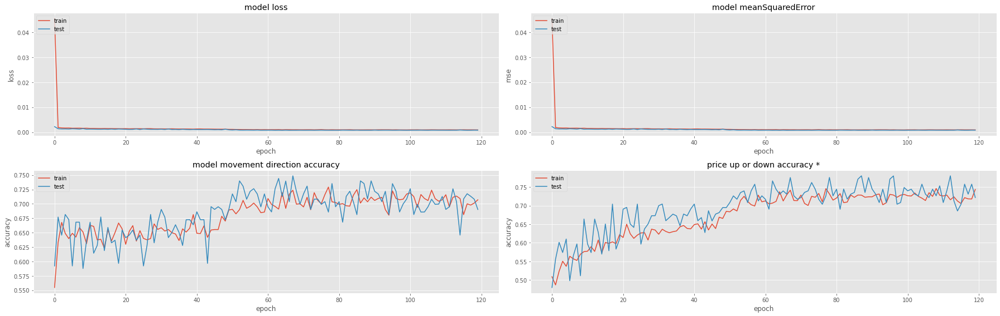

223/223 [==============================] - 1s 6ms/step - loss: 7.7027e-04 - mean_squared_error: 7.7027e-04 - movement_accuracy: 0.7354 - above_or_below_zero_accuracy: 0.7803
treinando fold 3, repetição 2 (400 epochs dá 2min +-)


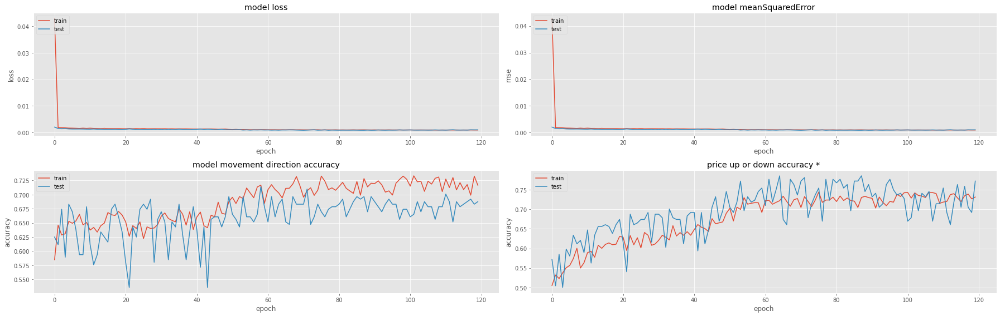

224/224 [==============================] - 1s 6ms/step - loss: 9.2812e-04 - mean_squared_error: 9.2812e-04 - movement_accuracy: 0.6920 - above_or_below_zero_accuracy: 0.7857
treinando fold 4, repetição 1 (400 epochs dá 2min +-)


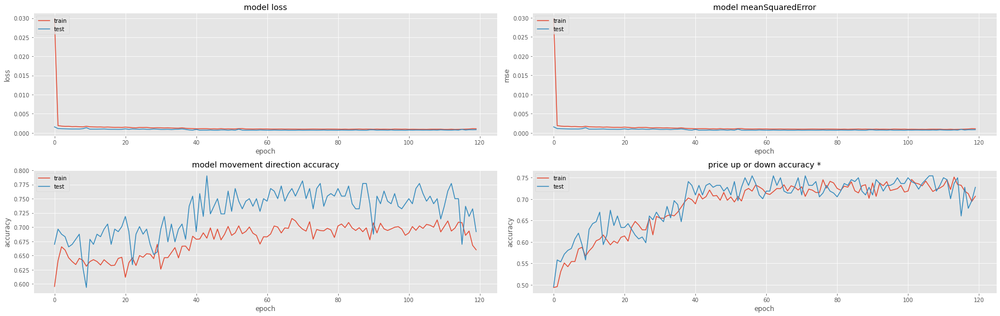

224/224 [==============================] - 1s 6ms/step - loss: 7.1541e-04 - mean_squared_error: 7.1541e-04 - movement_accuracy: 0.7366 - above_or_below_zero_accuracy: 0.7545
treinando fold 4, repetição 2 (400 epochs dá 2min +-)


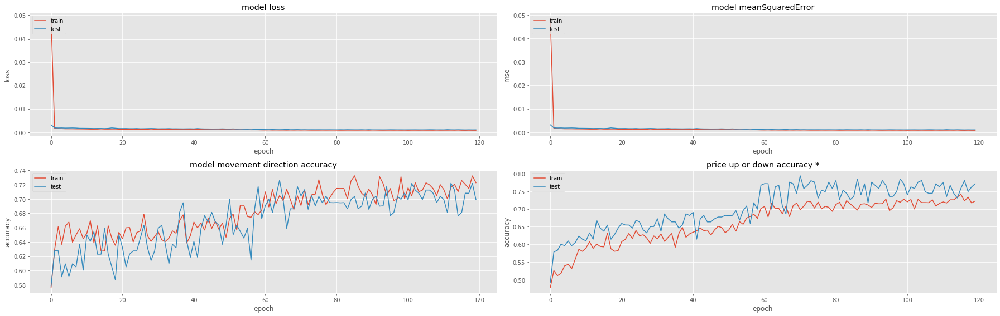

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7040 - above_or_below_zero_accuracy: 0.7937
treinando fold 5, repetição 1 (400 epochs dá 2min +-)


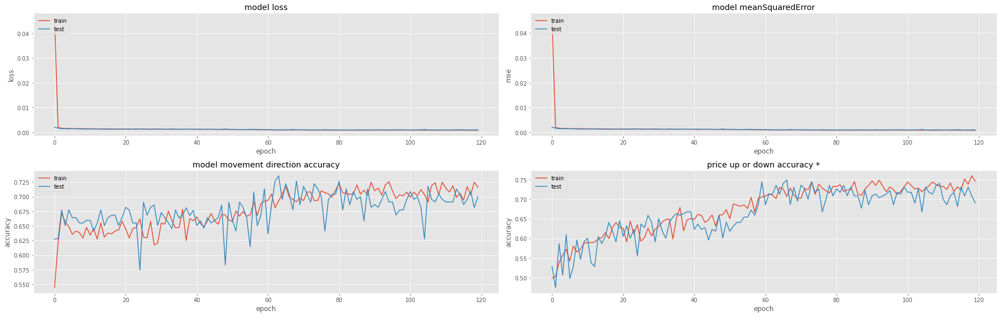

223/223 [==============================] - 1s 6ms/step - loss: 0.0010 - mean_squared_error: 0.0010 - movement_accuracy: 0.7040 - above_or_below_zero_accuracy: 0.7489
treinando fold 5, repetição 2 (400 epochs dá 2min +-)


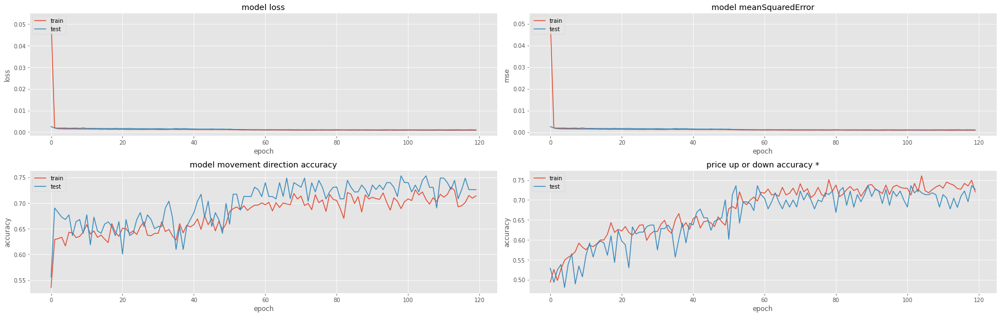

223/223 [==============================] - 1s 6ms/step - loss: 0.0011 - mean_squared_error: 0.0011 - movement_accuracy: 0.7130 - above_or_below_zero_accuracy: 0.7354

Results:

MeanSquaredError: [0.0010120822116732597, 0.0010461308993399143, 0.0009634232264943421, 0.0007395835127681494, 0.0007518210913985968, 0.0008105122251436114, 0.0006737373769283295, 0.0010339898290112615, 0.000984238344244659, 0.0010452577844262123]
MovementDiretionAccuracy: [0.7142857313156128, 0.7723214030265808, 0.7443946003913879, 0.726457417011261, 0.7488788962364197, 0.7142857313156128, 0.7901785969734192, 0.726457417011261, 0.7354260087013245, 0.7533632516860962]
AboveOrBellowAccuracy: [0.78125, 0.7589285969734192, 0.7802690863609314, 0.7443946003913879, 0.7802690863609314, 0.7857142686843872, 0.7544642686843872, 0.7937219738960266, 0.7488788962364197, 0.7354260087013245]
MeanSquaredError mean: 0.0009060776501428336
MovementDiretionAccuracy mean: 0.7426049053668976
AboveOrBellowAccuracy mean: 0.766331678628

In [32]:
features = [variation, volume_variation, google_trends]
target = variation
model_events = build_and_run_and_show(features, target, shuffle_mask, mean_squared_error)

desvio padrao

correlação

In [ ]:
def variation_to_price(base_price, prices, predictions):
    predicted_prices = np.empty_like(predictions)
    # n_samples = len(prices) - N - (foward_days-1)
    last_price = base_price
    for i in range(len(prices)):
        predicted_prices = last_price + (last_price * predictions[i])
        last_price = prices[i]